# Snake
## Find the best threshold for clump detection

Here we take the full cube and try to find clumps in empty regions close to the object (ie. false positives). This will help establish the limits on the dendrograms parameters

In [1]:
%matplotlib notebook
import matplotlib.pylab as plt
from matplotlib.patches import Ellipse
from matplotlib.patches import Polygon
from matplotlib.path import Path

import seaborn as sns
sns.set(style="whitegrid")
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import warnings
warnings.filterwarnings('ignore')

import numpy as np

from scipy.ndimage import filters

from astropy.io import fits
from astropy import units as u
from astropy.stats import sigma_clipped_stats
from astropy.table import Table,Column
from astropy.wcs import WCS
from reproject import reproject_interp

from astrodendro import Dendrogram, ppv_catalog
from astrodendro.analysis import PPVStatistic

from astropy.cosmology import WMAP9 as cosmo

## Load data and get observations properties

Load data

In [2]:
wcs_alma =  WCS(fits.getheader('../Data/Moments/snake_mom0.fits'))
wcs_alma.wcs.crpix = wcs_alma.wcs.crpix - [400,300] # to compensate the cropping
alma_header = fits.getheader('../Data/Moments/snake_mom0.fits')
mom0 = fits.getdata('../Data/Moments/snake_mom0.fits')[300:700,400:600]
mom1 = fits.getdata('../Data/Moments/snake_mom1.fits')[300:700,400:600]
alma = fits.open('../Data/Moments/snake_mom0.fits')[0]

HST_red,_ = reproject_interp('../Data/HST/snake_F160W.fits',alma.header)
HST_green,_ = reproject_interp('../Data/HST/snake_F814w.fits',alma.header)
HST_blue,_ = reproject_interp('../Data/HST/snake_F435w.fits',alma.header)

oii_vel, _ = reproject_interp('../Data/MUSE/MACS1206_model_atan.fits',alma.header)
oii_vel[np.where(oii_vel == 0)] = np.nan
oii_vel = oii_vel[300:700,400:600]

alma_data = fits.getdata('../Data/Cubes/snake_cube_v5.image.pbcor.fits') # vel,pix,pix 
alma_data = np.squeeze(alma_data)
wcs_cube = WCS(fits.getheader('../Data/Cubes/snake_cube_v5.image.pbcor.fits'))
wcs_cube = wcs_cube.dropaxis(3)
wcs_cube.wcs.crpix = wcs_cube.wcs.crpix - [300,400,100] # to compensate the cropping
crop_data = alma_data[100:140,300:700,400:600]# Cut also in spectral window in the same way we cut for the mom0
alma_im = np.nanmean(crop_data,axis=0)

def crop_image(im):
    return im[300:700,400:600]

# Load HST data to compare
hst_im,_ = reproject_interp('../Data/HST/snake_F160W.fits',alma_header)
hst_im = crop_image(hst_im)

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]
INFO: 
             

Channel width

In [3]:
from astropy.constants import c

def channel_width(file):
    wcs  = fits.getheader(file)
    print(-wcs['CDELT3']/wcs['CRVAL3']* c.to('km/s'))

channel_width('../Data/Cubes/snake_cube_v5.image.pbcor.fits')

10.301829601193552 km / s


Beam size

In [4]:
header = fits.getheader('../Data/Cubes/snake_cube_v5.image.pbcor.fits')

beam_area = np.pi /(4*np.log(2)) * header['BMAJ'] * header['BMIN']
beam_area_pix = beam_area/ header['CDELT1']**2
print('Beam_area in pix %0.2f'%beam_area_pix)
print('Beam area in arcsec: %0.2e'%beam_area)

# Calculate area but of a beam with less one pixel in radius
beam_area_min = np.pi /(4*np.log(2)) * (header['BMAJ']-abs(header['CDELT1'])) *( header['BMIN']-abs(header['CDELT1']))
beam_area_min_pix = beam_area_min/ header['CDELT1']**2
print('Beam_area in pix %0.2f'%beam_area_min_pix)
print('Beam area in arcsec: %0.2e'%beam_area_min)

Beam_area in pix 27.91
Beam area in arcsec: 3.45e-09
Beam_area in pix 17.76
Beam area in arcsec: 2.19e-09


Flux units

In [5]:
header['BUNIT']

'Jy/beam'

Beam size in image plane (to be put in source plane using lenstool)

<IPython.core.display.Javascript object>


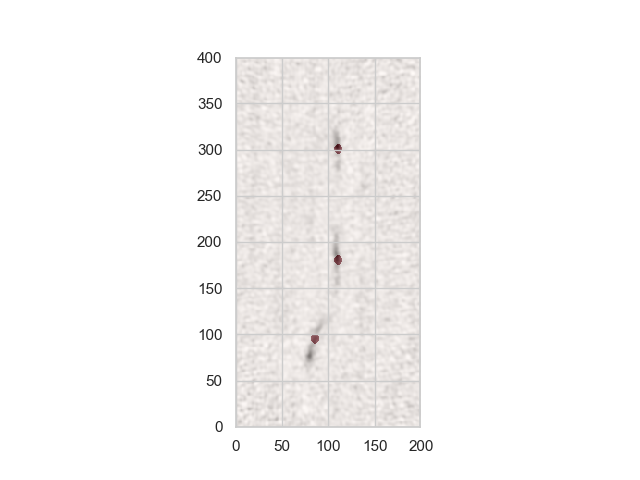

In [6]:
def beam(x0,y0,a=4.3442E-05/8.333E-06,b=3.8018E-05/8.333E-06):
    x,y = np.mgrid[0:mom0.shape[0],0:mom0.shape[1]]
    ellipse = ((x-x0)/a)**2 + ((y-y0)/b)**2 < 1
    return ellipse.astype(int)

elli_south = beam(95,85)
elli_centre = beam(180,110)
elli_north = beam(300,110)
elli_all = elli_north+elli_centre+elli_south

fig, ax = plt.subplots(1,1)
ax.imshow(mom0,origin='lower',cmap='Greys')
ax.imshow(elli_all,origin='lower',alpha=0.5,cmap='Reds')

fits.writeto('../Data/LensigStuff/MACS1206/beams.fits',data=elli_all,header=wcs_alma.to_header(),overwrite=True)

Measure physical size of them beam (in source plane)

<IPython.core.display.Javascript object>


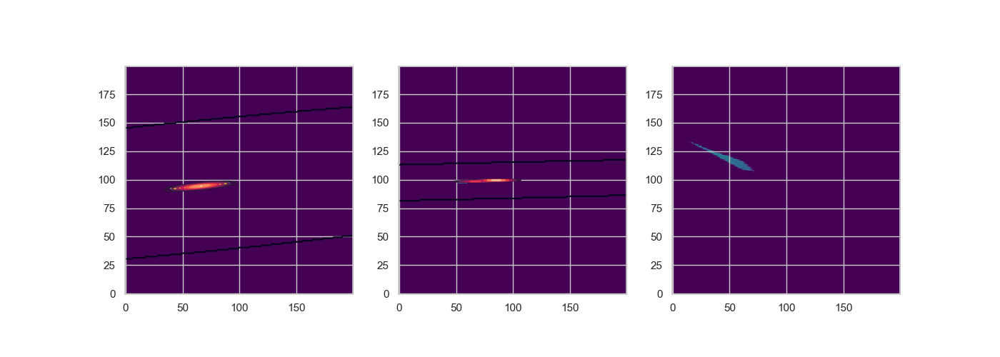

Complete north: 1.07 0.10
Complete centre: 0.98 0.03
Complete south: 0.00 0.02


In [7]:
from astropy.modeling import models, fitting

beam_source_plane_north = fits.getdata('../Data/LensigStuff/MACS1206/SP_beam_north.fits')
beam_source_plane_centre = fits.getdata('../Data/LensigStuff/MACS1206/SP_beam_centre.fits')
beam_source_plane_south = fits.getdata('../Data/LensigStuff/MACS1206/SP_beam_south.fits')
header_source_plane = fits.getheader('../Data/LensigStuff/MACS1206/SP_beam_north.fits')

# Plot
fig, ax = plt.subplots(1,3,figsize=(14,5))
ax[0].imshow(beam_source_plane_north[500:-500,500:-500],origin='lower',vmin=0,vmax=1,cmap='viridis')
ax[1].imshow(beam_source_plane_centre[500:-500,500:-500],origin='lower',vmin=0,vmax=1,cmap='viridis')
ax[2].imshow(beam_source_plane_south[500:-500,500:-500],origin='lower',vmin=0,vmax=1,cmap='viridis')


# Fit
y, x = np.mgrid[:beam_source_plane_north.shape[0], :beam_source_plane_north.shape[1]]

# Fit complete image beam
p_init = models.Gaussian2D(x_mean=567,y_mean=593)
fit_p = fitting.LevMarLSQFitter()
p = fit_p(p_init, x, y, beam_source_plane_north)
ax[0].contour(p(x, y)[500:-500,500:-500], origin='lower')
print('Complete north: %0.2f %0.2f'%(p.x_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(1.033).value, p.y_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(1.04).value)) 

# Fit east
p_init = models.Gaussian2D(x_mean=573,y_mean=598)
fit_p = fitting.LevMarLSQFitter()
p = fit_p(p_init, x, y, beam_source_plane_centre)
ax[1].contour(p(x, y)[500:-500,500:-500], origin='lower')
print('Complete centre: %0.2f %0.2f'%(p.x_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(1.033).value, p.y_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(1.04).value)) 

# Fit west
p_init = models.Gaussian2D(x_mean=556,y_mean=618)
fit_p = fitting.LevMarLSQFitter()
p = fit_p(p_init, x, y, beam_source_plane_south)
ax[2].contour(p(x, y)[500:-500,500:-500], origin='lower')
print('Complete south: %0.2f %0.2f'%(p.x_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(1.033).value, p.y_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(1.04).value)) 

### Define empty and HST regions

<IPython.core.display.Javascript object>


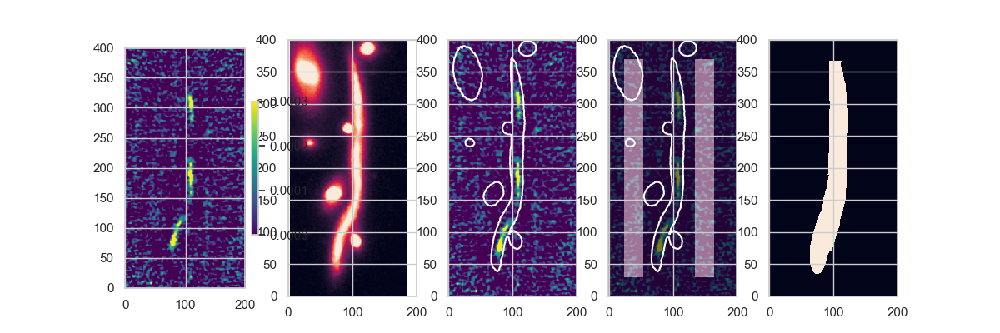

Pixels in HST region: 9728
Pixels in empty region 1: 11900
Pixels in empty region 2: 10200


In [5]:
# Load HST image and make mask
hst_smooth = filters.gaussian_filter(hst_im, sigma=5)
rms_hst = np.sqrt(np.nanmean((hst_im - np.nanmean(hst_im))**2))
mask = hst_smooth > 0.5*rms_hst
mask[200:400,:80]  = 0 
mask[368:,:]  = 0 
mask[240:280,:93]  = 0 
x,y = np.meshgrid(range(mask.shape[0]),range(mask.shape[1]))
mask[np.where((y > 4.8*x -255) & (x<180) & (y<190) & (y>130))] = 0
mask[np.where((y < 3.2*x -240) & (x<200) & (y<150) )] = 0

# Define empty regions
box1 = np.zeros_like(hst_im)
box1[30:370,25:55] = 1
box1[30:370,135:165] = 1

mask1 = np.zeros_like(hst_im)
mask2 = np.zeros_like(hst_im)
mask2[30:370,25:55] = 1
mask1[30:370,130:165] = 1

# Plot
fig, ax = plt.subplots(1,5,figsize=(12,4))
cax = ax[0].imshow(alma_im,vmin=0,vmax=0.0003,origin='lower',cmap='viridis')
cbar = fig.colorbar(cax,fraction=0.05,ax=ax[0])

ax[1].imshow(hst_im,origin='lower',vmax=0.1,vmin=0)

ax[2].imshow(alma_im,vmin=0,vmax=0.0003,origin='lower',cmap='viridis')
ax[2].contour(hst_im,levels=[0.05],colors='w')

ax[3].imshow(alma_im,vmin=0,vmax=0.0003,origin='lower',cmap='viridis')
ax[3].contour(hst_im,levels=[0.05],colors='w',linewidth=0.8)
ax[3].imshow(box1,origin='lower',alpha=0.5)

ax[4].imshow(mask,origin='lower')

print('Pixels in HST region: %d'%len(np.where(mask==1)[1]))
print('Pixels in empty region 1: %d'%len(np.where(mask1==1)[1]))
print('Pixels in empty region 2: %d'%len(np.where(mask2==1)[1]))

In [6]:
_,_,rms1 = sigma_clipped_stats(crop_data[:,30:370,25:55])
_,_,rms2 = sigma_clipped_stats(crop_data[:,30:370,130:165])
_,_,rmstot = sigma_clipped_stats(crop_data)


print('RMS box1 %0.6f'%rms1)
print('RMS box2 %0.6f'%rms2)
print('RMS tot %0.6f'%rmstot)

rms = np.mean((rms1,rms2))
print('Mean RMS %0.6f'%rms)

RMS box1 0.000322
RMS box2 0.000324
RMS tot 0.000335
Mean RMS 0.000323


In [7]:
# Limit to structures within the HST data
from astrodendro.pruning import all_true

def is_inside_box1(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return mask1[peak_index[1],peak_index[2]]

def is_inside_box2(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return mask2[peak_index[1],peak_index[2]]

def is_inside_box(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return np.any((mask1[peak_index[1],peak_index[2]],mask2[peak_index[1],peak_index[2]]))

def is_inside_hst(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return mask[peak_index[1],peak_index[2]]

# Limit to structures that span at least 2 channels
def min_2_chan(structure, index=None, value=None):
    return len(set(structure.indices()[0])) >= 2.

def min_beam_size(structure, index=None, value=None):
    """ Loop in the channels to make sure at least one has more than 19 pixels (spatial direction)."""
    c, x, y = structure.indices()
    test = False
    for channel in set(c):
        pix = np.where(c==channel)
        if len(x[pix]) > 18. :
            test = True
    return test

In [8]:
def plot_to_compare(d,p,title,im=alma_im):

    # 3D selection
    fig,ax = plt.subplots(1, 2, figsize=(12,5))
    fig.suptitle(title)
    ax[0].imshow(im, origin='lower', interpolation='nearest',cmap=plt.cm.Blues, vmax=2*rms,vmin=0)

    leaves = []
    for nb,leaf in enumerate(d.leaves):
        leaves.append(leaf.idx)
        p.plot_contour(ax[0], structure=leaf, lw=3, colors='orange')
        s = PPVStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='m', facecolor='none',lw=1.5)
        ax[0].add_patch(ellipse)
        ax[0].annotate('%s'%nb,xy=ellipse.center,color='m')     


    # Draw beam
    beam = Ellipse(xy=(235,100), width=6.8, height=5.7, angle=7.287213897705E+01,facecolor='k')
    ax[0].add_artist(beam)

    p.plot_tree(ax[1], color='black')
    ax[1].set_xlabel("Structure")
    ax[1].set_ylabel("Flux")

### Establish the fiducual thresholds

Keep delta=1 and find the calue of min_value for which there are no detections in the empty region.

<IPython.core.display.Javascript object>


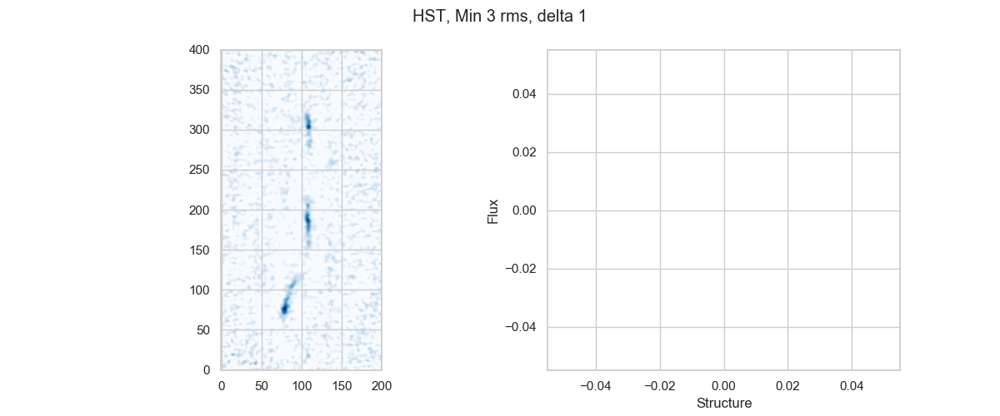

<IPython.core.display.Javascript object>


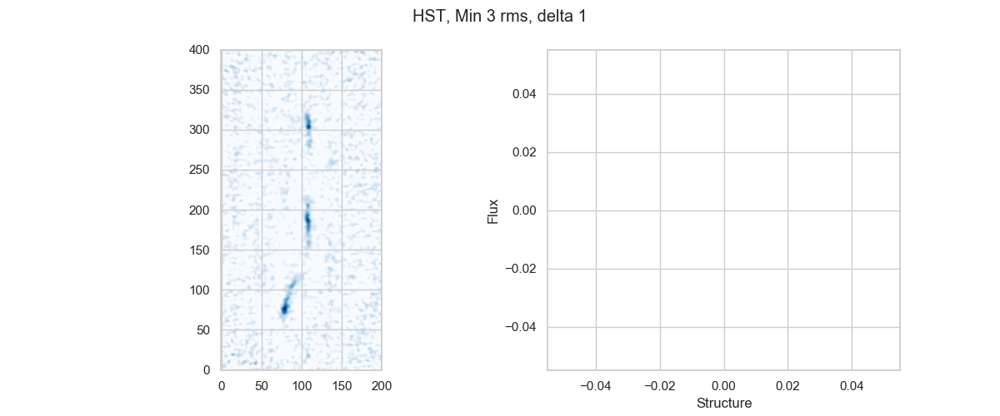

<IPython.core.display.Javascript object>


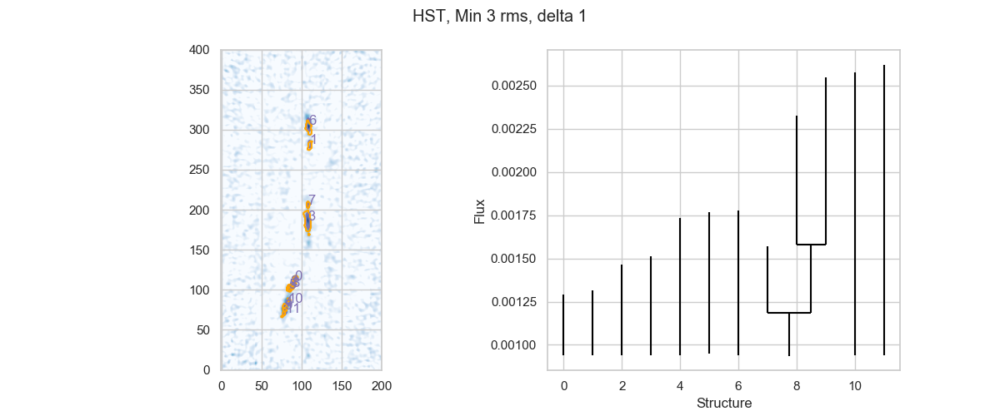

In [9]:
rms_fiducial = 2.9

d_M3D1_B1 = Dendrogram.compute(crop_data,min_value=rms_fiducial*rms,min_delta=1*rms,min_npix=0,
                               is_independent=all_true((is_inside_box1,min_beam_size,min_2_chan)))
p_M3D1_B1 = d_M3D1_B1.plotter()
plot_to_compare(d_M3D1_B1,p_M3D1_B1,'HST, Min 3 rms, delta 1',im=alma_im)

d_M3D1_B2 = Dendrogram.compute(crop_data,min_value=rms_fiducial*rms,min_delta=1*rms,min_npix=0,
                               is_independent=all_true((is_inside_box2,min_beam_size,min_2_chan)))
p_M3D1_B2 = d_M3D1_B2.plotter()
plot_to_compare(d_M3D1_B2,p_M3D1_B2,'HST, Min 3 rms, delta 1',im=alma_im)

d_M3D1_C = Dendrogram.compute(crop_data,min_value=rms_fiducial*rms,min_delta=1*rms,min_npix=0,
                              is_independent=all_true((is_inside_hst,min_beam_size,min_2_chan)))
p_M3D1_C = d_M3D1_C.plotter()
plot_to_compare(d_M3D1_C,p_M3D1_C,'HST, Min 3 rms, delta 1',im=alma_im)

In [10]:
metadata = {'data_unit': u.Jy }
cat_M3D1_C = ppv_catalog(d_M3D1_C.leaves, metadata,verbose=False)

## Define what are the best values of Fmin and Delta

In [11]:
from normalize import APLpyNormalize

def make_rgb_image(im_r,im_g,im_b,min_p=(3.,3.,3.),mid_p=(70.,70.,70.),max_p=(99.5,99.5,99.5),stretch='arcsinh',plot=False):
    '''
    Takes 3 images and makes an rgb image.
    From David Carton.
    Parameters:
    -----------
    im_r: array
        red image
    im_g: array
        green image
    im_b: array
        blue image
    min_p: float
        percentile to calculate vmin of the image
    mid_p: float
        vmid
    max_p: float
        vmax
    Returns
    -----
    image (array)
    ''' 

    valid = np.isfinite(im_r)
    valid &= np.isfinite(im_g)
    valid &= np.isfinite(im_b)

    im_r[~valid] = 0.
    im_g[~valid] = 0.
    im_b[~valid] = 0.

    vmin, vmid, vmax = np.percentile(im_r, [min_p[0], mid_p[0], max_p[0]])
    norm = APLpyNormalize(stretch=stretch, vmin=vmin, vmax=vmax,
                      vmid=vmid)
    im_r = norm(im_r, clip=True)

    vmin, vmid, vmax = np.percentile(im_g, [min_p[1], mid_p[1], max_p[1]])
    norm = APLpyNormalize(stretch=stretch, vmin=vmin, vmax=vmax,
                      vmid=vmid)
    im_g = norm(im_g, clip=True)

    vmin, vmid, vmax = np.percentile(im_b, [min_p[2], mid_p[2], max_p[2]])
    norm = APLpyNormalize(stretch=stretch, vmin=vmin, vmax=vmax,
                      vmid=vmid)
    im_b = norm(im_b, clip=True)

    image = np.array([im_r, im_g, im_b])
    image = np.rollaxis(image, 0, 3)

    if plot:
        ratio = float(image.shape[0]) / float(image.shape[1])
        fig = plt.figure(figsize=(10.,10*ratio), frameon=False)
        ax = fig.add_axes([0,0,1,1])
        ax.set_axis_off()
        ax.imshow(image, interpolation='nearest', origin='lower')
    
    return image

In [12]:
def to_ds9_reg(ellipses,wcs,outfile):
    
    f = open(outfile,'w')
    f.write('# Region file format: DS9 version 4.1\n')
    f.write('global color=red dashlist=8 3 width=1 font="helvetica 10 normal roman" select=1 highlite=1 dash=0 fixed=0 edit=1 move=1 delete=1 include=1 source=1\n')
    f.write('fk5\n')
    
    for e in ellipses:
        centre = wcs.all_pix2world(e.center[0],e.center[1],0)
        h,w = e.height*abs(wcs_alma.wcs.cdelt[0])*3600, e.width*abs(wcs_alma.wcs.cdelt[0])*3600 # in arcsec
        f.write('ellipse(%0.12f,%0.12f,%0.4f",%0.4f",%d)\n'%(centre[0],centre[1],h,w,e.angle+90))
    
    f.close()

In [13]:
def plot_alma(d,p,name):
    
    x = ax[1]
    cmap = sns.cubehelix_palette(start=0, light=1, as_cmap=True)
    x.imshow(mom0, origin='lower', vmax=0.2,vmin=-0.01)

    ellip_list = []
    for nb,leaf in enumerate(d.leaves):
        p.plot_contour(x, structure=leaf, linewidths=1, colors='#5ca904')
        s = PPVStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='w', facecolor='0.8',lw=1,alpha=0.65)
        ellip_list.append(ellipse)
        x.add_patch(ellipse)
    to_ds9_reg(ellip_list,wcs_alma,name)

    x.add_artist(Ellipse(xy=(25,50), width=5.9814E-05/1.111E-05, height=5.0839E-05/1.111E-05, angle=8.49E+01,facecolor='w'))
    x.hlines(y=20,xmin=20,xmax=20+(1/(1.111E-05 *3600)),color='w')
    x.annotate('1"',xy=(20, 24), color='w',fontsize=10)

    x.axis('off')

rgb_as1063 = make_rgb_image(HST_red,HST_green,HST_blue,(5,5,5),(10,10,10),(99.95,99.96,99.96))[300:700,400:600]
def plot_hst(d,p):
    
    x = ax[2]
    x.imshow(rgb_as1063, origin='lower')

    for nb,leaf in enumerate(d.leaves):
        p.plot_contour(x, structure=leaf, linewidths=1, colors='#5ca904')
        
    x.axis('off')

def plot_muse(d,p):
    
    x = ax[3]
    cax = x.contour(oii_vel,levels=np.arange(-100,100,20),cmap="RdBu_r",linewidths=0.8,inline=1)
    cmap = plt.cm.RdBu_r
    cmap.set_bad('#516572',0.4)
    cax = x.imshow(mom1,origin='lower',cmap="RdBu_r",vmin=-100,vmax=100)
    plt.colorbar(cax,ax=x,fraction=0.04)
    

    for nb,leaf in enumerate(d.leaves):
        p.plot_contour(x, structure=leaf, linewidths=0.5, colors='#5ca904')

    x.axis('off')

def plot_scatter(d_C,d_B1,d_B2):
    
    x = ax[0]
    sns.scatterplot([-1,-1],[-1,-1],marker='',ax=x)
    
    try:
        cat_B1 = ppv_catalog(d_B1.leaves, metadata,verbose=False)
        sns.scatterplot(cat_B1['flux'],cat_B1['radius'],marker='s',alpha=0.8, color=sns.xkcd_rgb['cornflower'],s=70,
                   label='Empty region 1',ax=x)
        nb_B1 = len(cat_B1)
    except AttributeError:
        nb_B1 = np.nan
        print('No detections in Box 1') 
        
    try:
        cat_B2 = ppv_catalog(d_B2.leaves, metadata,verbose=False)
        sns.scatterplot(cat_B2['flux'],cat_B2['radius'],marker='s',alpha=0.8, color=sns.xkcd_rgb['olive green'],s=70,
                   label='Empty region 2',ax=x)
        nb_B2 = len(cat_B2)
    except AttributeError:
        nb_B2= np.nan
        print('No detections in Box 2')
    
    cat_C = ppv_catalog(d_C.leaves, metadata,verbose=False)
    nb_C = len(cat_C)
    sns.scatterplot(cat_C['flux'],cat_C['radius'],marker='o',color=sns.xkcd_rgb['dark pink'],alpha=0.8,s=60,
                    label='Target region',ax=x)

    x.set_xlabel('Flux (Jy)')
    x.set_ylabel('Radius (arcsec)')
    #x.set_xlim(0,0.01)
    #x.set_ylim(0,0.1)
    
    print('Number of clumps %d'%nb_C)

    return (nb_C,np.nansum((nb_B1,nb_B2)))
    

In [14]:
def plot_dwcs_region(imagefile,dwcsfile,ra_ref,dec_ref,im_levels=None,plot=False,color=False):
    '''
    To plot the weird dwcs lenstool files in normal coordinates.
    Parameters:
    -----------
    imagefile: string
        image where the regions were drawn
    dwcsfile: string
        contour file 
    ra_ref,dec_ref: float,float
        at the begingin of the lenstool main file (.par), where it says 'reference 3'
    im_levels: float,float
        for plotting the image
    Returns:
    --------
        polygon
    '''
    im = fits.getdata(imagefile)
    w = WCS(fits.getheader(imagefile))

    ## Read dwcs file 
    nb,cont_x,cont_y = np.loadtxt(dwcsfile,unpack=True)
            
    vertices = []
    for (x_rel,y_rel) in zip(cont_x,cont_y):
            ## putting it back to normal coordinates...
            ra  = x_rel/ (-3600*np.cos(dec_ref/180*np.pi)) + ra_ref
            dec = y_rel / 3600 + dec_ref
            ## Put back in image coordinates
            x,y = w.wcs_world2pix(ra,dec,1)
            vertices.append((x,y))
            #plt.plot(x,y,'ro',markersize=6)

    poly = Polygon(vertices,True,alpha=0.2,color='r',joinstyle='round')
      
    if plot:
        plt.figure()
        ax = plt .subplot(111)
        if im_levels == None:
                plt.imshow(im,aspect='equal')
        else:
                plt.imshow(im,aspect='equal',vmin=im_levels[0],vmax=im_levels[1])
        ax.add_collection(poly,autolim=False)
        plt.show()
    
    # Make polygon into a mask
    y, x = np.mgrid[:im.shape[0], :im.shape[1]]
    points = np.transpose((x.ravel(), y.ravel()))
    poly_path = Path(vertices)
    mask = poly_path.contains_points(points).reshape(im.shape)
    
    poly.set_facecolor('None')
    poly.set_linewidth(1)
    poly.set_alpha(1)
    if color is not False:
        poly.set_edgecolor(color)
    
    return poly,mask

<IPython.core.display.Javascript object>


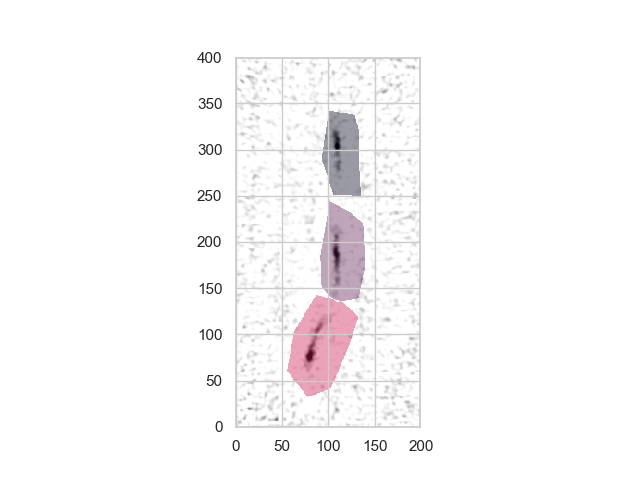

In [15]:
reg1_poly,reg1 = plot_dwcs_region('../Data/Moments/snake_mom0.fits','../Data/LensigStuff/MACS1206/north.dwcs',181.550606, -8.800926 ,color='C1')
reg2_poly,reg2 = plot_dwcs_region('../Data/Moments/snake_mom0.fits','../Data/LensigStuff/MACS1206/centre.dwcs',181.550606, -8.800926 ,color='C2')
reg3_poly,reg3 = plot_dwcs_region('../Data/Moments/snake_mom0.fits','../Data/LensigStuff/MACS1206/south.dwcs',181.550606, -8.800926 ,color='C3')

hst = fits.getdata('../Data/HST/snake_F160W.fits')

reg1 = crop_image(reg1)
reg2 = crop_image(reg2)
reg3 = crop_image(reg3)

fullmask =  reg1*1. + reg2*2. + reg3*3.
fullmask[np.where(fullmask==0)] = np.nan

plt.figure()
plt.imshow(alma_im,cmap='Greys',origin='lower',vmax=0.0005,vmin=0)
plt.imshow(fullmask,origin='lower',alpha=0.4)

Make final catalogue with all combinations

In [16]:
def which_multiple_region(clump):
    
    north = reg1_poly.contains_point((clump[0]+400,clump[1]+300))
    centre = reg2_poly.contains_point((clump[0]+400,clump[1]+300))
    south = reg3_poly.contains_point((clump[0]+400,clump[1]+300))
    
    reg_idx = np.array((1,2,3))
    tests = np.array((north,centre,south))
    
    if np.any(tests):
        return reg_idx[np.array((north,centre,south))][0]
    
    else:
        return 0

<IPython.core.display.Javascript object>


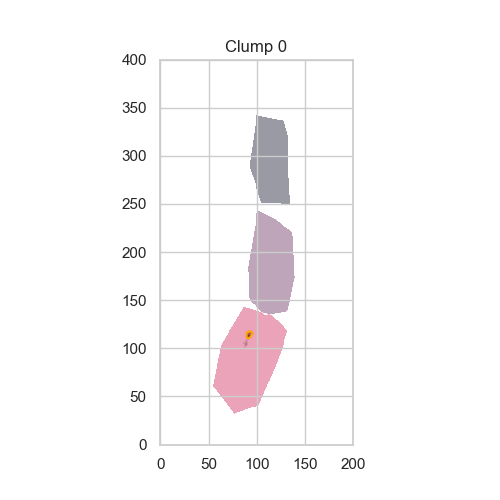

Multiple region 3


<IPython.core.display.Javascript object>


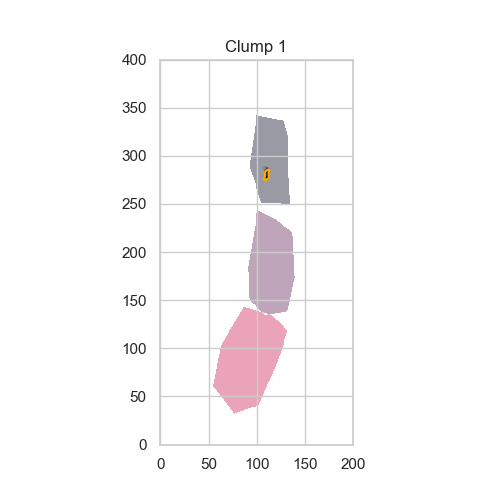

Multiple region 1


<IPython.core.display.Javascript object>


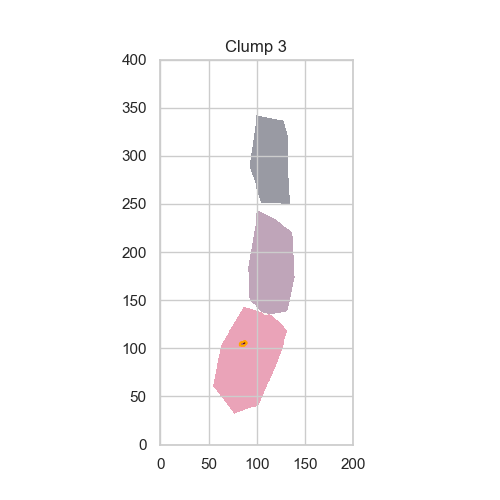

Multiple region 3


<IPython.core.display.Javascript object>


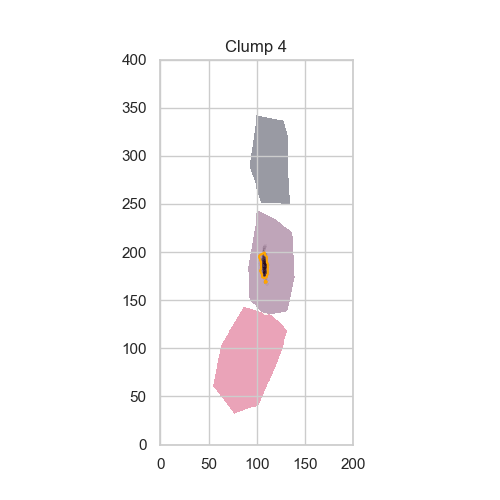

Multiple region 2


<IPython.core.display.Javascript object>


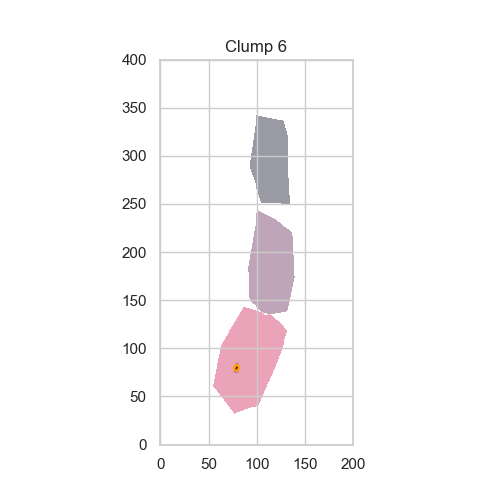

Multiple region 3


<IPython.core.display.Javascript object>


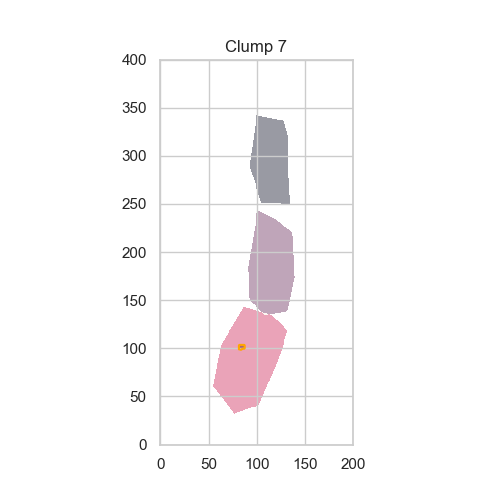

Multiple region 3


<IPython.core.display.Javascript object>


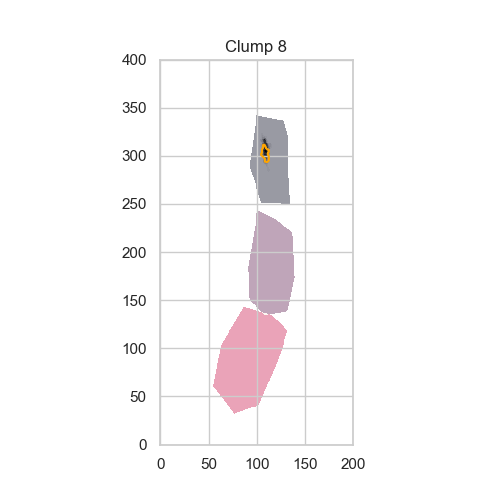

Multiple region 1


<IPython.core.display.Javascript object>


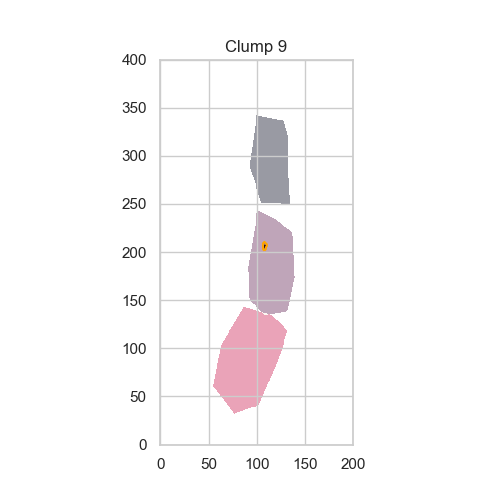

Multiple region 2


<IPython.core.display.Javascript object>


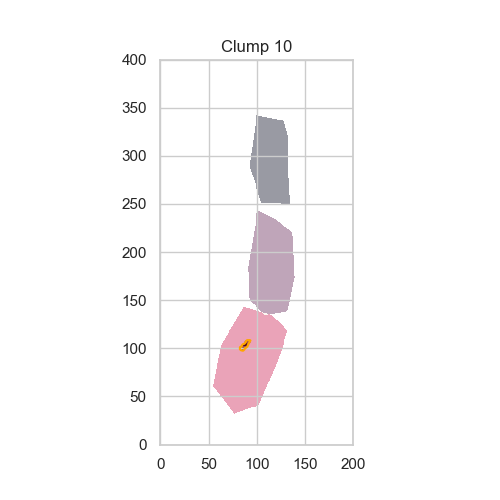

Multiple region 3


<IPython.core.display.Javascript object>


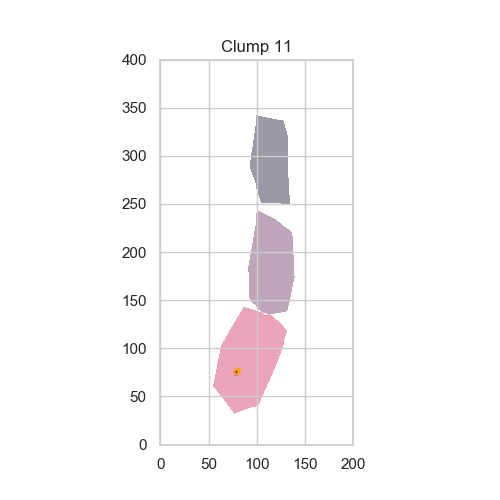

Multiple region 3


<IPython.core.display.Javascript object>


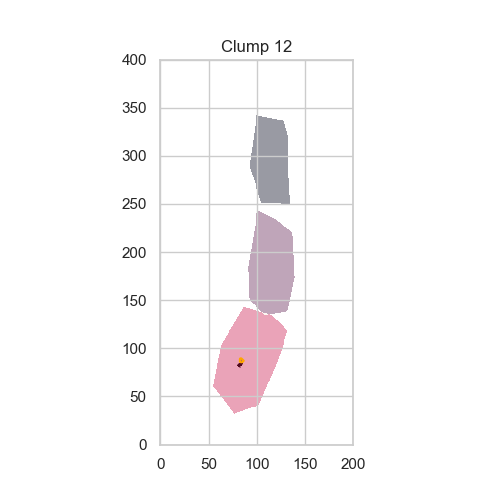

Multiple region 3


<IPython.core.display.Javascript object>


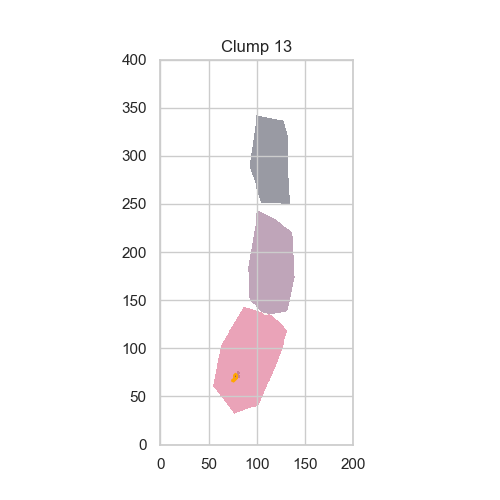

Multiple region 3


In [20]:
def test(d,p,c):
    
    cat_test = ppv_catalog(d.leaves, metadata,verbose=False) 

    for nb,leaf in enumerate(d.leaves):
        mask = np.sum(leaf.get_mask(),axis=0)
        fig,ax = plt.subplots(1, 1, figsize=(5,5))
        ax.imshow(mask,origin='lower',cmap='Greys')
        ax.imshow(fullmask,origin='lower',alpha=0.4)
        p.plot_contour(ax, structure=leaf, lw=3, colors='orange')
        ax.set_title('Clump %d'%leaf.idx)
        clump = c[nb]
        print('Multiple region',which_multiple_region((clump['x_cen'],clump['y_cen']))) 
        
test(d_M3D1_C,p_M3D1_C,cat_M3D1_C)   

Find clumps using a combination of Fmin and deltas

<IPython.core.display.Javascript object>


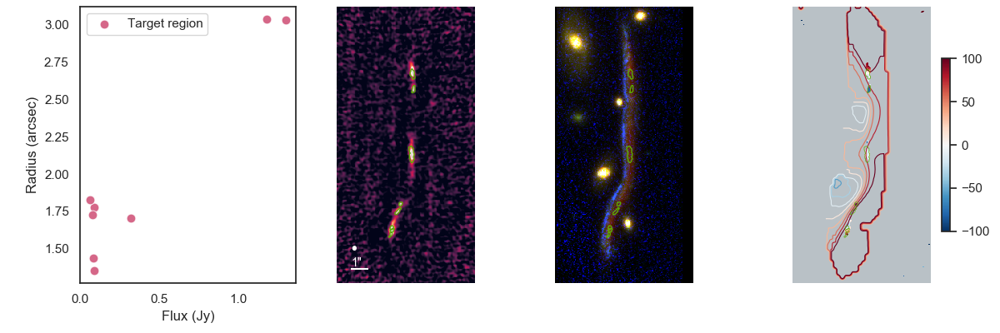

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


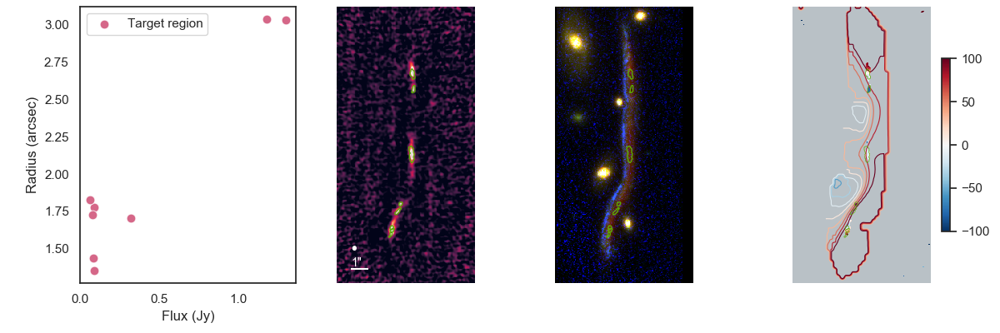

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


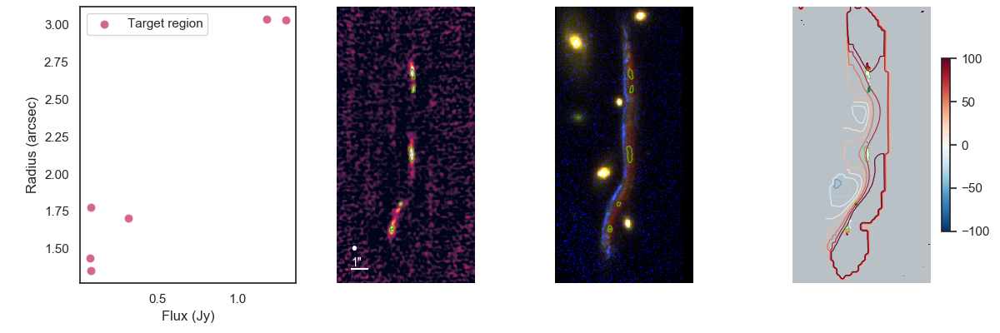

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


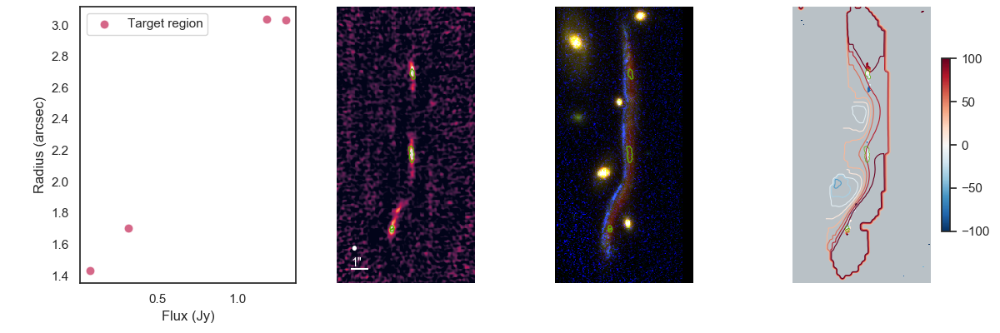

No detections in Box 1
No detections in Box 2
Number of clumps 4


<IPython.core.display.Javascript object>


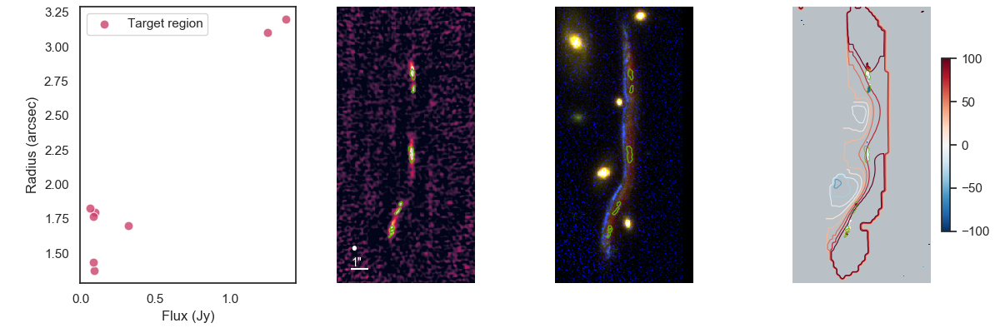

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


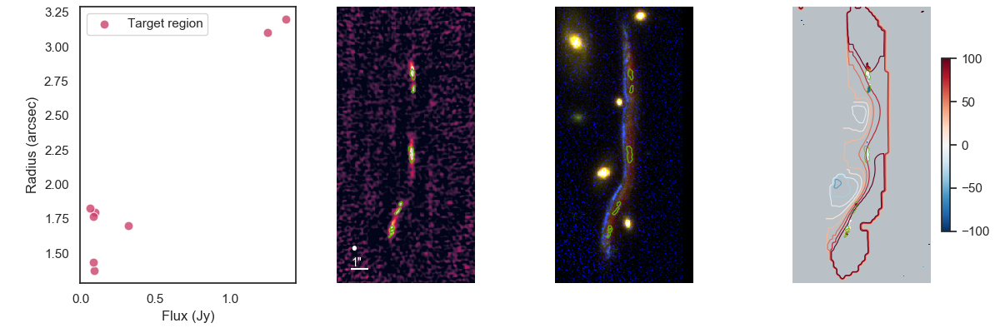

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


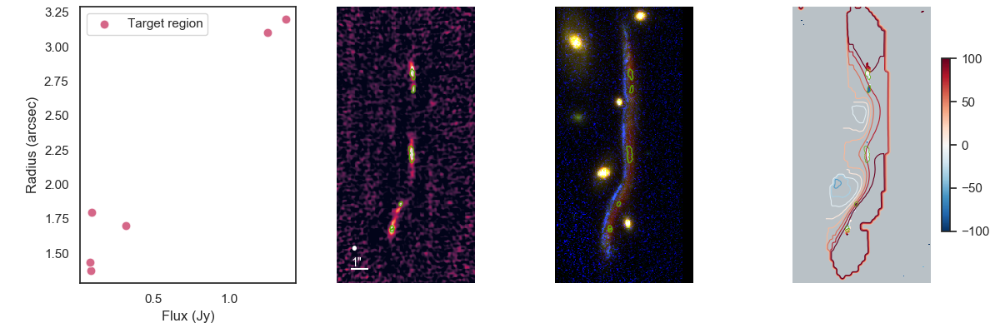

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


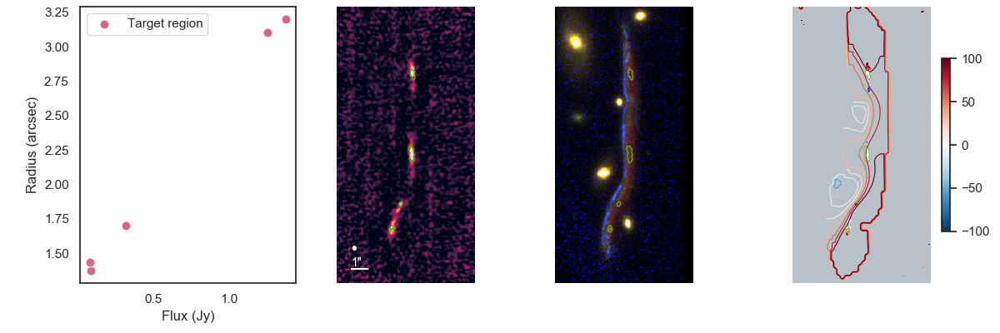

No detections in Box 1
No detections in Box 2
Number of clumps 5


<IPython.core.display.Javascript object>


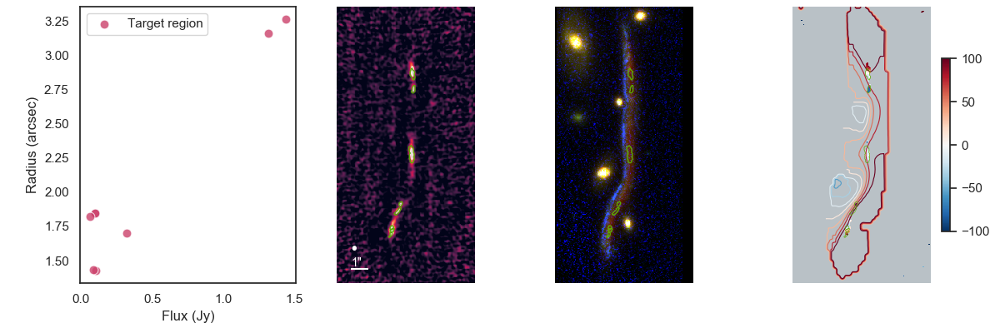

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


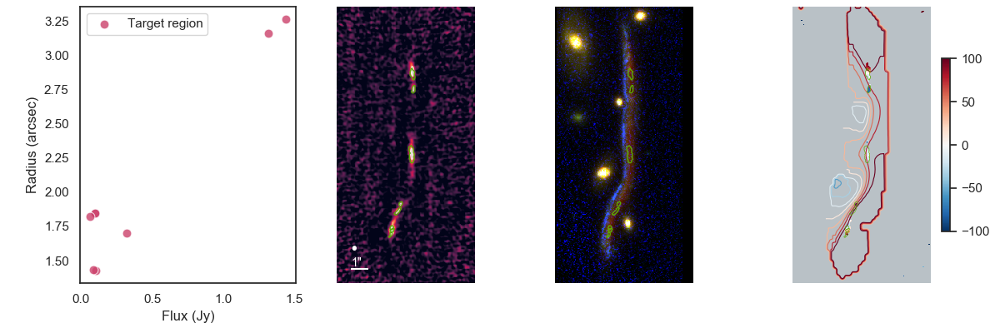

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


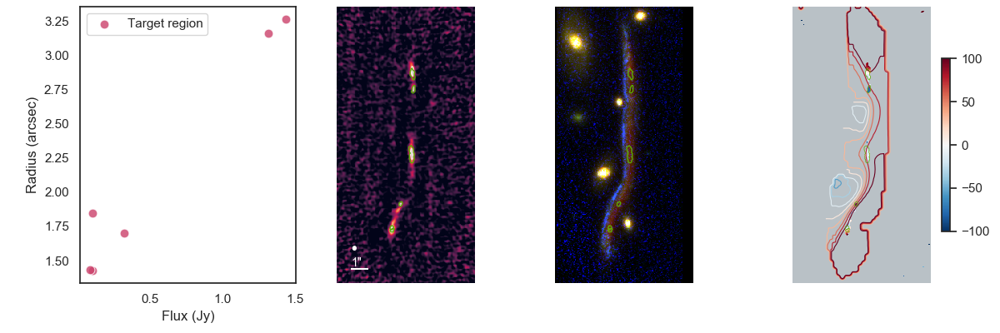

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


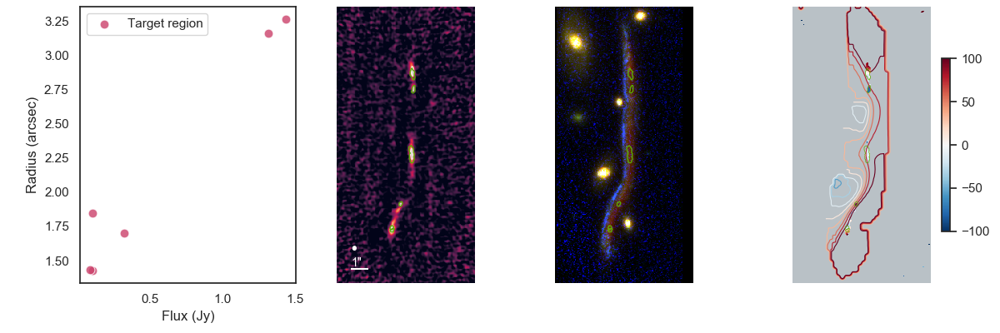

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


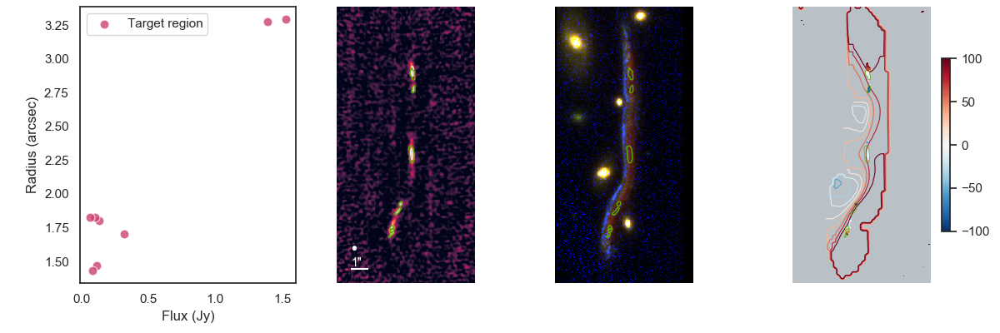

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


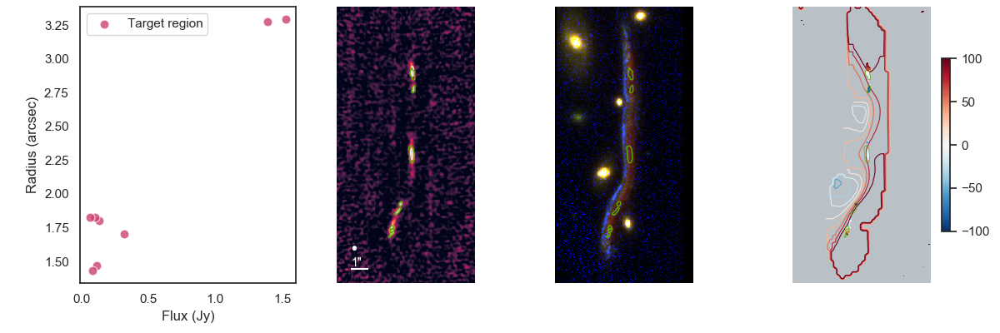

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


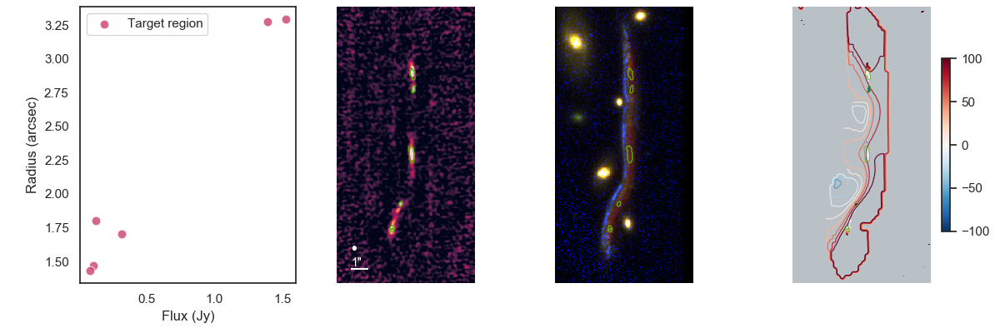

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


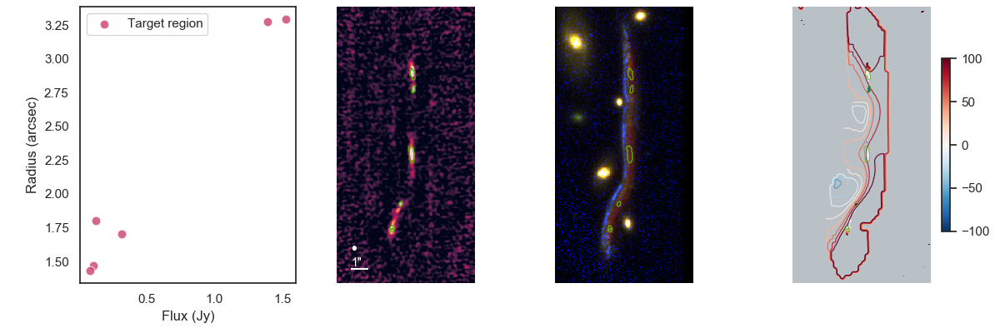

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


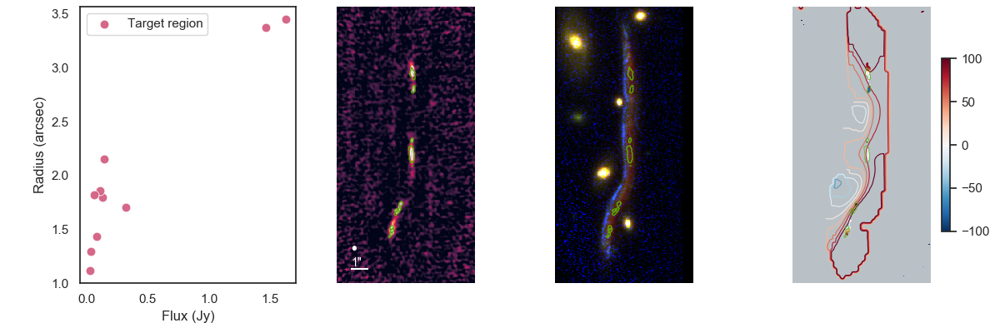

No detections in Box 1
No detections in Box 2
Number of clumps 10


<IPython.core.display.Javascript object>


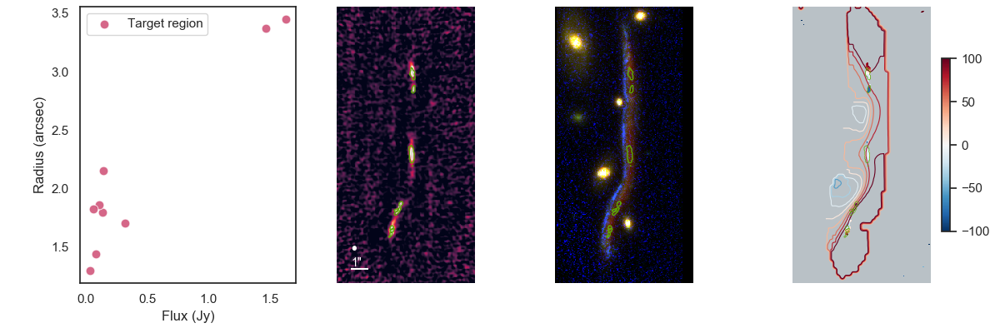

No detections in Box 1
No detections in Box 2
Number of clumps 9


<IPython.core.display.Javascript object>


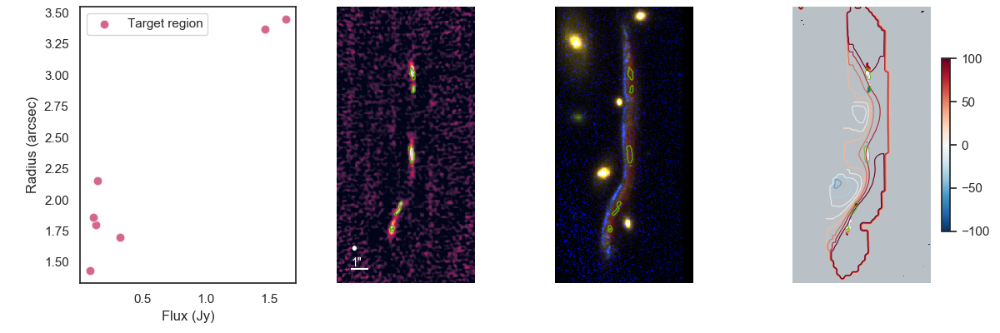

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


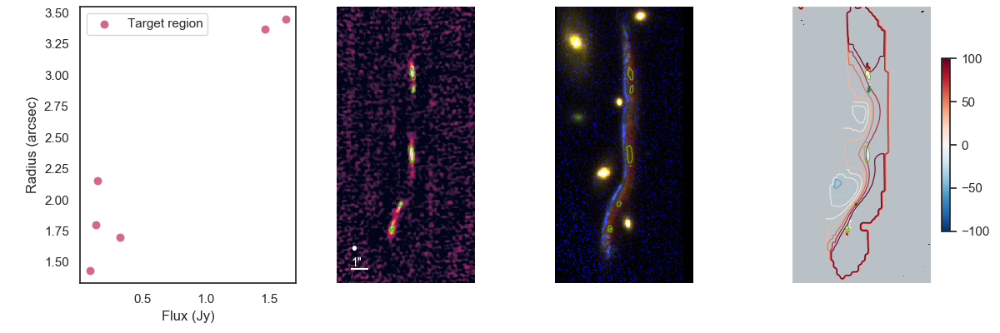

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


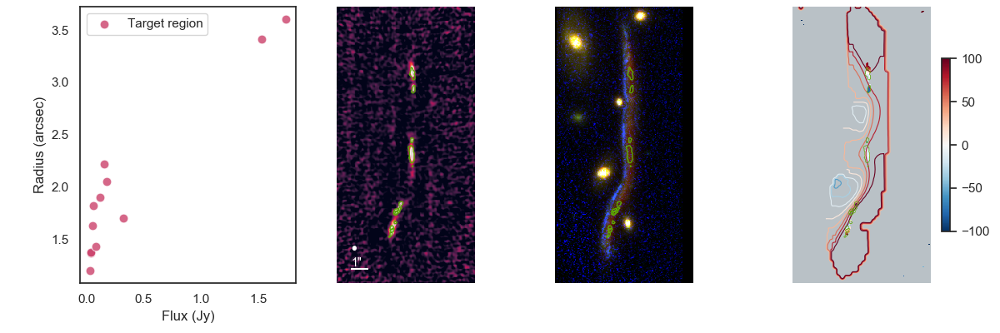

No detections in Box 1
No detections in Box 2
Number of clumps 12


<IPython.core.display.Javascript object>


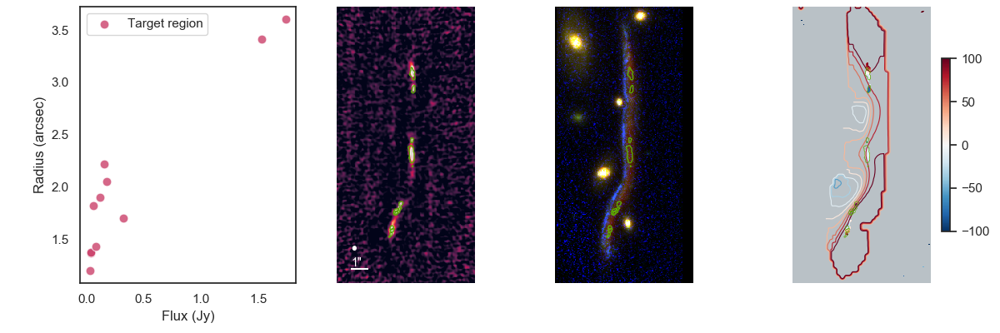

No detections in Box 1
No detections in Box 2
Number of clumps 11


<IPython.core.display.Javascript object>


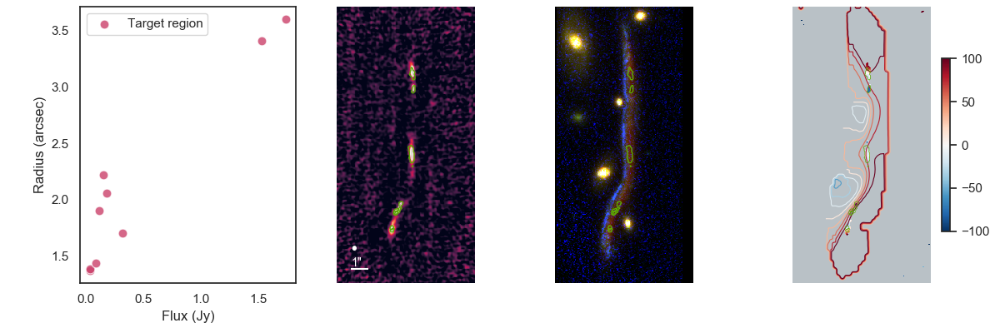

No detections in Box 1
No detections in Box 2
Number of clumps 9


<IPython.core.display.Javascript object>


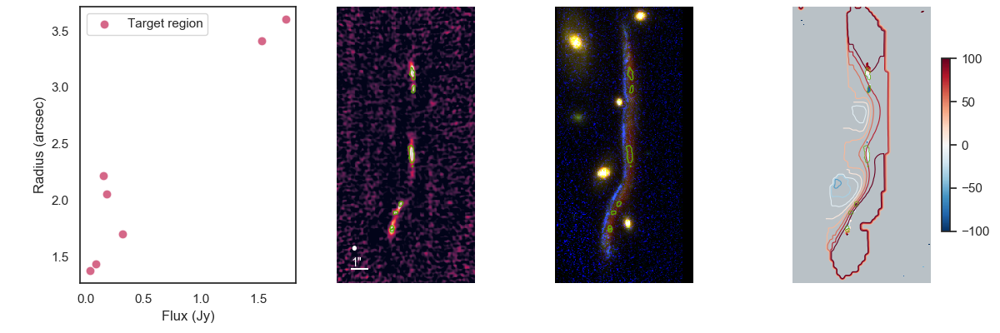

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


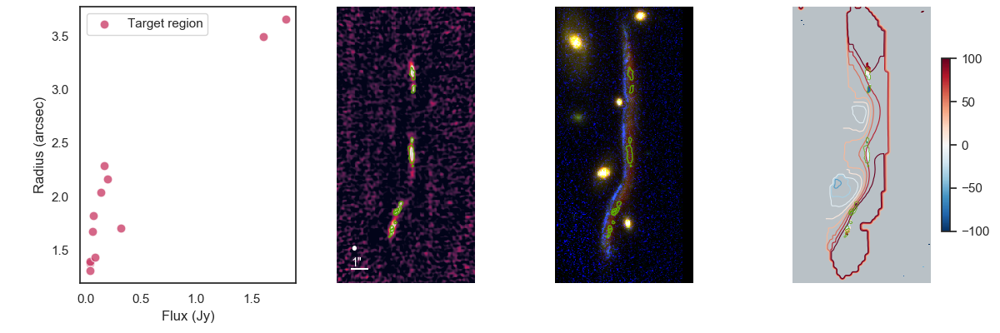

No detections in Box 1
No detections in Box 2
Number of clumps 12


<IPython.core.display.Javascript object>


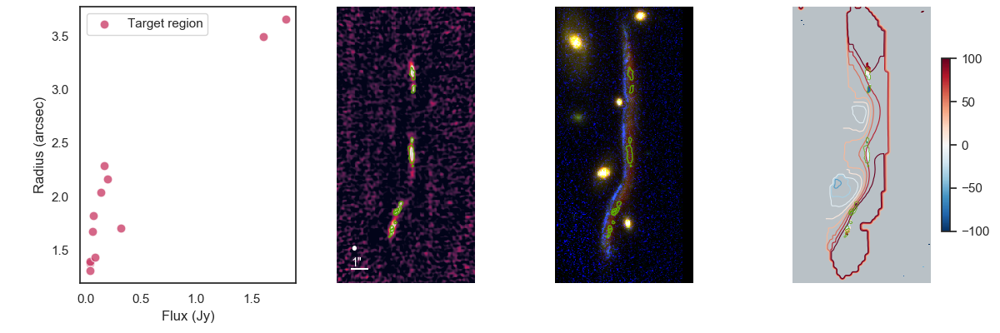

No detections in Box 1
No detections in Box 2
Number of clumps 12


<IPython.core.display.Javascript object>


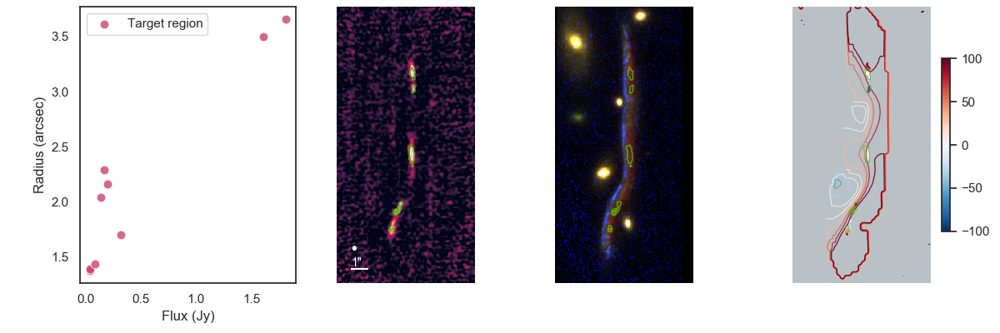

No detections in Box 1
No detections in Box 2
Number of clumps 9


<IPython.core.display.Javascript object>


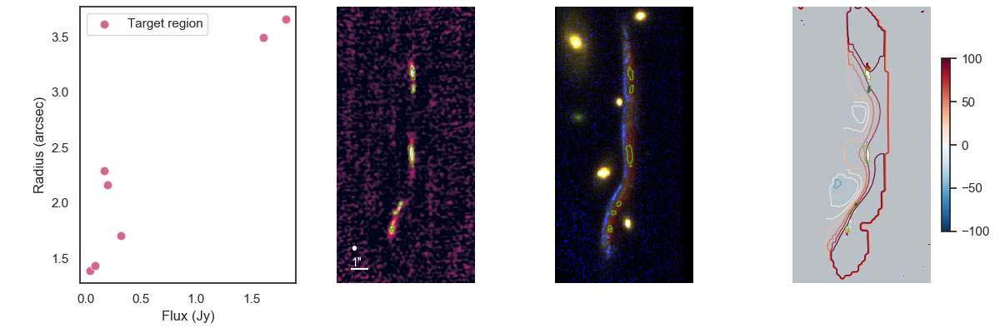

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


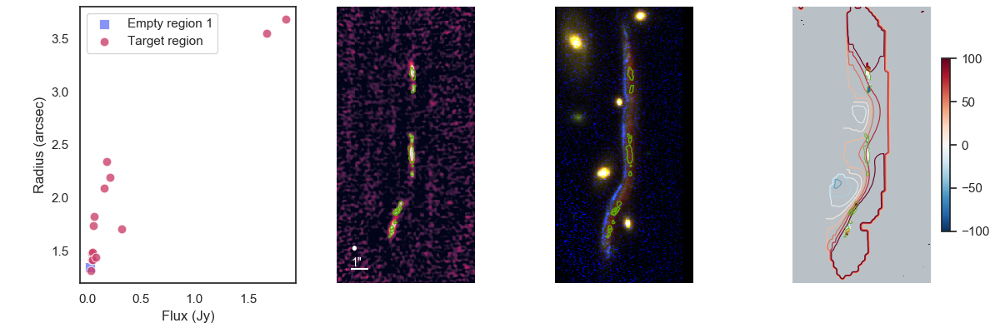

No detections in Box 2
Number of clumps 14


<IPython.core.display.Javascript object>


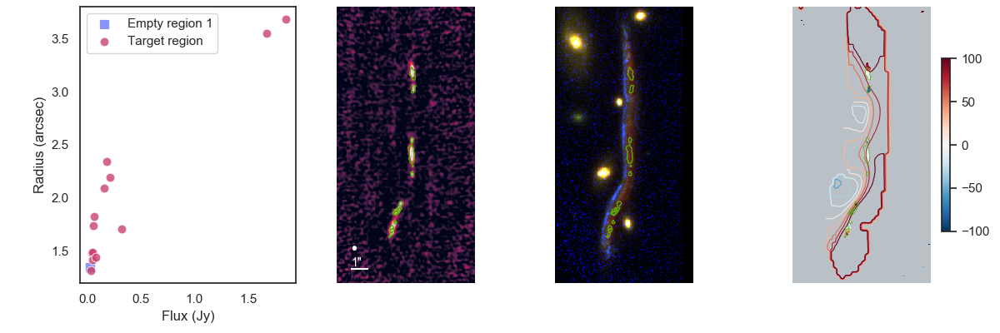

No detections in Box 2
Number of clumps 13


<IPython.core.display.Javascript object>


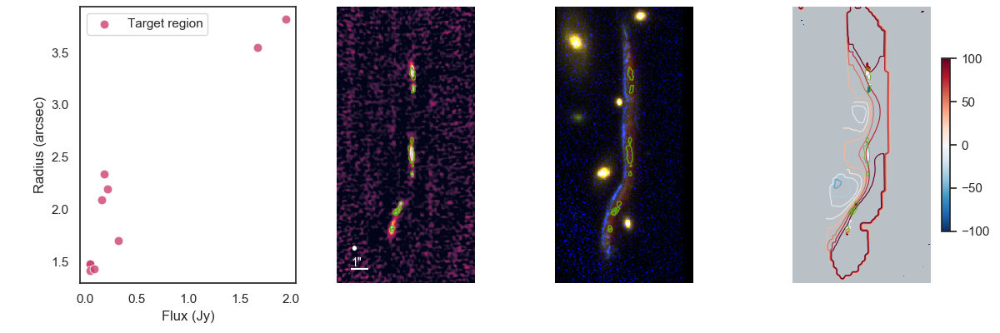

No detections in Box 1
No detections in Box 2
Number of clumps 10


<IPython.core.display.Javascript object>


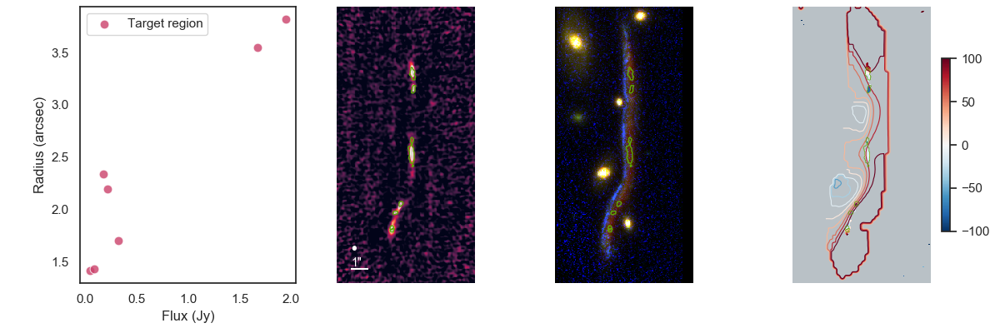

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


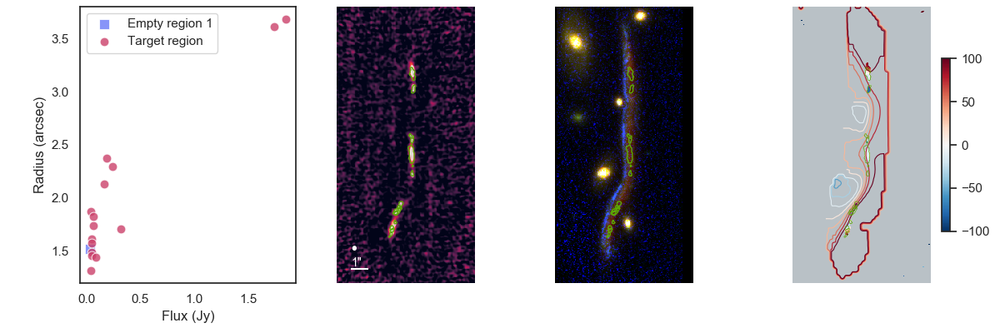

No detections in Box 2
Number of clumps 15


<IPython.core.display.Javascript object>


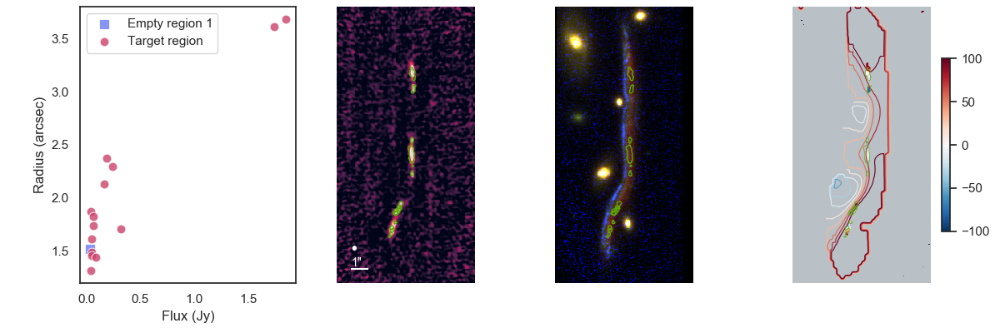

No detections in Box 2
Number of clumps 14


<IPython.core.display.Javascript object>


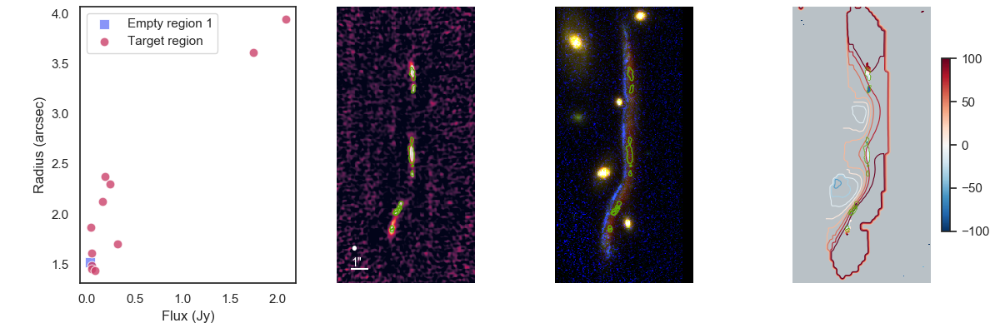

No detections in Box 2
Number of clumps 11


<IPython.core.display.Javascript object>


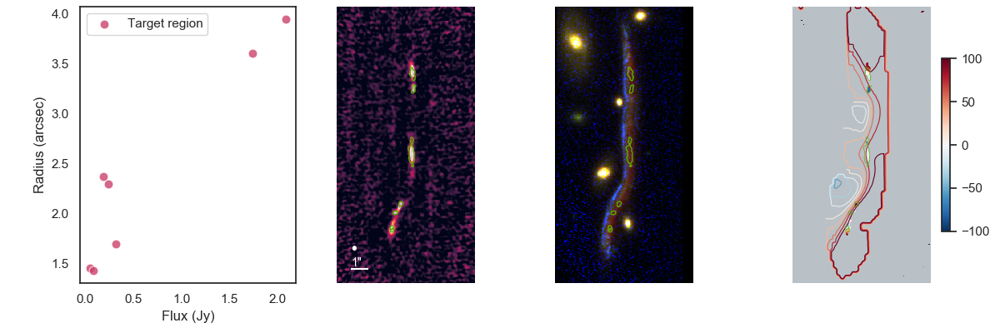

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


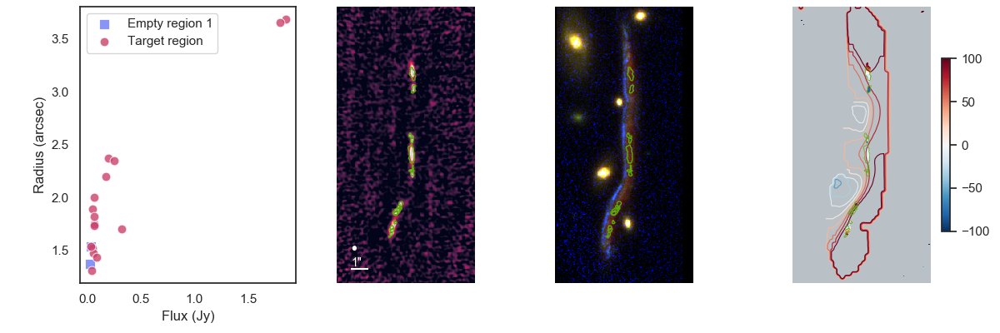

No detections in Box 2
Number of clumps 16


<IPython.core.display.Javascript object>


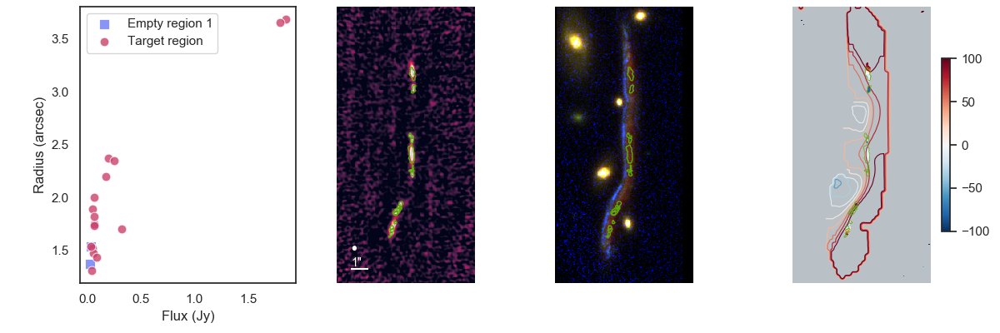

No detections in Box 2
Number of clumps 16


<IPython.core.display.Javascript object>


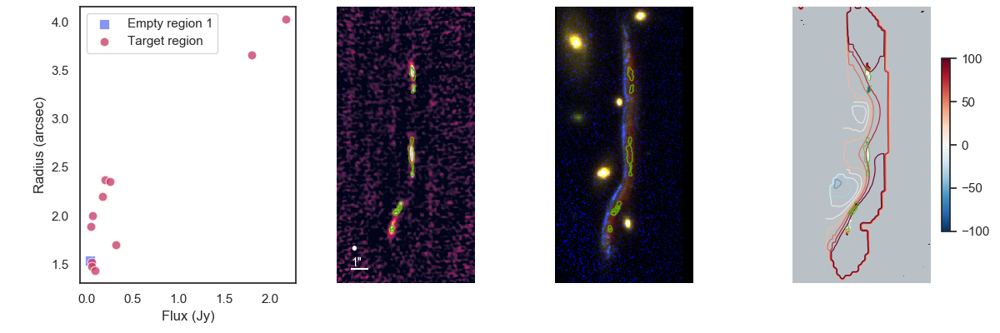

No detections in Box 2
Number of clumps 11


<IPython.core.display.Javascript object>


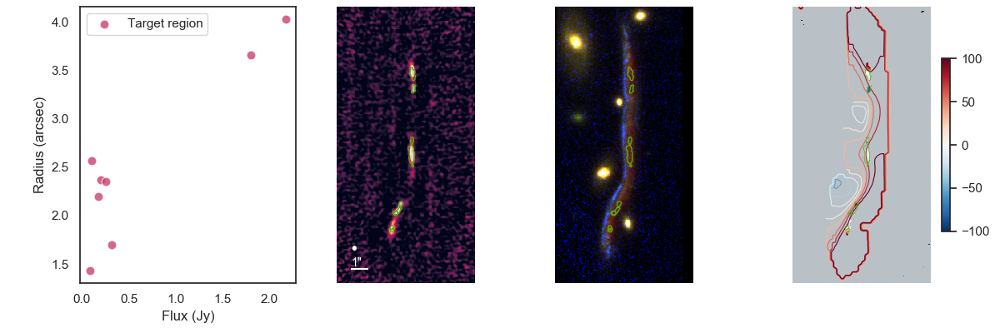

No detections in Box 1
No detections in Box 2
Number of clumps 8


<IPython.core.display.Javascript object>


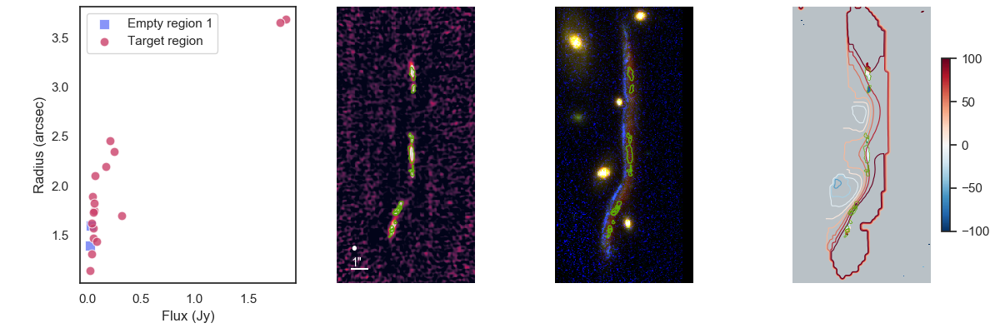

No detections in Box 2
Number of clumps 17


<IPython.core.display.Javascript object>


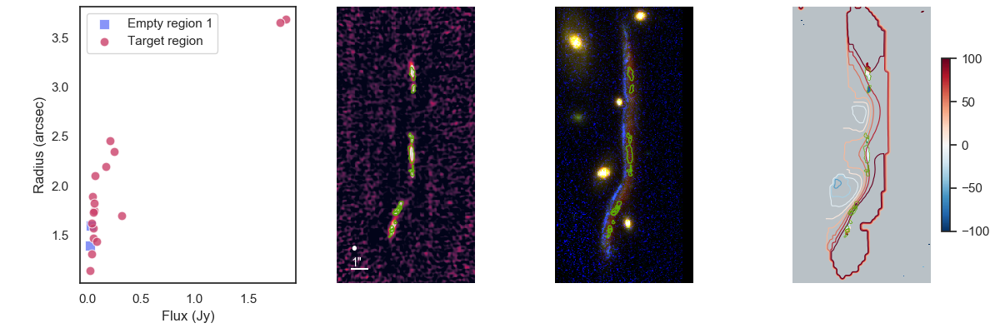

No detections in Box 2
Number of clumps 17


<IPython.core.display.Javascript object>


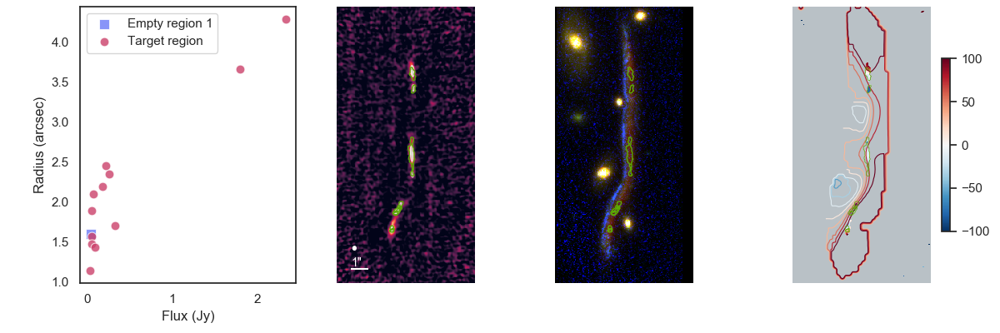

No detections in Box 2
Number of clumps 12


<IPython.core.display.Javascript object>


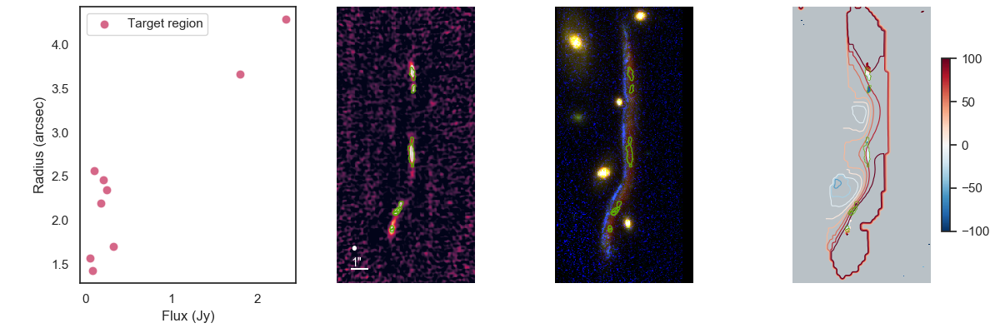

No detections in Box 1
No detections in Box 2
Number of clumps 9


In [27]:
sns.set_style('white')

nb_fmin = []
nb_delta = []
nb_clumps = []
nb_clumps_north = []
nb_clumps_centre = []
nb_clumps_south = []
nb_empty = []
nb_empty_B1 = []
nb_empty_B2 = []
    
for fmin in np.arange(3.5,2.4,-0.1):

    for delta in [0.5,1.,1.5,2.0]:

        d_C = Dendrogram.compute(crop_data,min_value=fmin*rms,min_delta=delta*rms,min_npix=0,
                                     is_independent=all_true((is_inside_hst,min_beam_size,min_2_chan)))
        p_C = d_C.plotter()
        cat_c =  ppv_catalog(d_C.leaves, metadata,verbose=False) 
        mlt_image = [which_multiple_region((c['x_cen'],c['y_cen'])) for c in cat_c]

        d_B2 = Dendrogram.compute(crop_data,min_value=fmin*rms,min_delta=delta*rms,min_npix=0,
                                        is_independent=all_true((is_inside_box1,min_beam_size,min_2_chan)))

        d_B1 = Dendrogram.compute(crop_data,min_value=fmin*rms,min_delta=delta*rms,min_npix=0,
                                        is_independent=all_true((is_inside_box2,min_beam_size,min_2_chan)))

        fig, ax = plt.subplots(1,4,figsize=(12,4))
        fig.subplots_adjust(top=0.98,bottom=0.15,left=0.08,right=0.95,wspace=0.01)
        plot_alma(d_C,p_C,'dummy')
        plot_hst(d_C,p_C)
        plot_muse(d_C,p_C)
        nb_c,nb_e = plot_scatter(d_C,d_B1,d_B2)

        nb_fmin.append(fmin)
        nb_delta.append(delta)

        nb_clumps.append(nb_c)
        nb_clumps_north.append(mlt_image.count(1))
        nb_clumps_centre.append(mlt_image.count(2))
        nb_clumps_south.append(mlt_image.count(3))

        nb_empty.append(nb_e)
        nb_empty_B1.append(len(d_B1.leaves))
        nb_empty_B2.append(len(d_B2.leaves))

Save table

In [28]:
## Save table
t = Table(data = [np.round(nb_fmin,2),nb_delta,nb_clumps,nb_clumps_north,nb_clumps_centre,nb_clumps_south,nb_empty,nb_empty_B1,nb_empty_B2],
          names=['Fmin','Delta','NbClumps','NbClumps_N','NbClumps_C','NbClumps_S','NbFalse','NbFalse1','NbFalse2'])
t.write('snake_clump_detections_10kms.tab',format='ascii.fixed_width_two_line')

Plot results

<IPython.core.display.Javascript object>


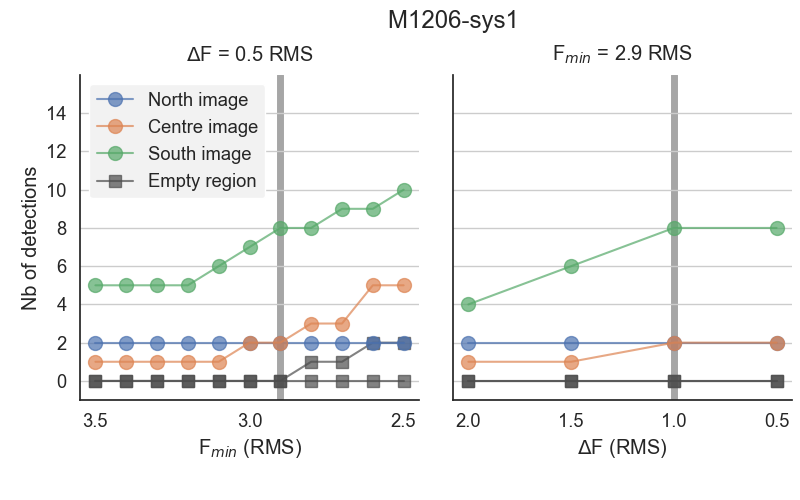

In [33]:
sns.set(font_scale=1.2)
sns.set_style('white')

fig, ax = plt.subplots(1,2,figsize=(8,5))
fig.subplots_adjust(top=0.85,bottom=0.2,left=0.1,right=0.99,wspace=0.1)
fig.suptitle('                M1206-sys1')

t = Table.read('snake_clump_detections_10kms.tab',format='ascii.fixed_width_two_line')

# Variation of Fmin, keeping Delta to 1
ax[0].set_title('$\Delta$F = 0.5 RMS',pad=10)
t_fmin = t[np.where(t['Delta']==1)]
ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps_N'],label='North image',marker='o',alpha=0.7,zorder=2,markersize=10)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps_C'],label='Centre image',marker='o',alpha=0.7,zorder=2,markersize=10)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps_S'],label='South image',marker='o',alpha=0.7,zorder=2,markersize=10)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbFalse1'],label='Empty region',marker='s',alpha=0.7,color='0.3',zorder=1,markersize=8)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbFalse2'],marker='s',alpha=0.7,color='0.3',zorder=1,label='',markersize=8)

ax[0].invert_xaxis()
ax[0].set_ylabel('Nb of detections')
ax[0].set_xlabel('F$_{min}$ (RMS)')
ax[0].legend(loc=2,fancybox=True, framealpha=1,edgecolor='w',facecolor='0.95')
ax[0].set_ylim(-2,21)
ax[0].axvline(2.9,linewidth=5,color='0.5',alpha=0.7,zorder=0)

# Variation of Delta, keeping Fmin to 2.9
ax[1].set_title('F$_{min}$ = 2.9 RMS',pad=10)
t_delta = t[np.where(t['Fmin']==2.9)]
t_delta.show_in_notebook()
ax[1].plot(t_delta['Delta'],t_delta['NbClumps_N'],marker='o',alpha=0.7,markersize=10)
ax[1].plot(t_delta['Delta'],t_delta['NbClumps_C'],marker='o',alpha=0.7,markersize=10)
ax[1].plot(t_delta['Delta'],t_delta['NbClumps_S'],marker='o',alpha=0.7,markersize=10)
ax[1].plot(t_delta['Delta'],t_delta['NbFalse1'],marker='s',alpha=0.7,color='0.3',markersize=8)
ax[1].plot(t_delta['Delta'],t_delta['NbFalse2'],marker='s',alpha=0.7,color='0.3',markersize=8)

ax[1].invert_xaxis()
ax[1].set_ylabel('')
ax[1].set_xlabel('$\\Delta$F (RMS)')
ax[1].axvline(1,linewidth=5,color='0.5',alpha=0.7,zorder=0)


# Set axes
sns.despine()

### Y axis is common ##
ax[0].set_ylim(-1,16)
ax[1].set_ylim(-1,16)
ax[0].yaxis.grid(True)
ax[1].yaxis.grid(True)
ax[0].set_yticks(range(0,16,2))
ax[1].set_yticks(range(0,16,2))
ax[1].set_yticklabels([''])

### X axis is common ##
ax[0].set_xticks(np.arange(3.5,2.0,-0.5))

fig.savefig('../Plots/snake_clump_detections.jpeg')

With total

<IPython.core.display.Javascript object>


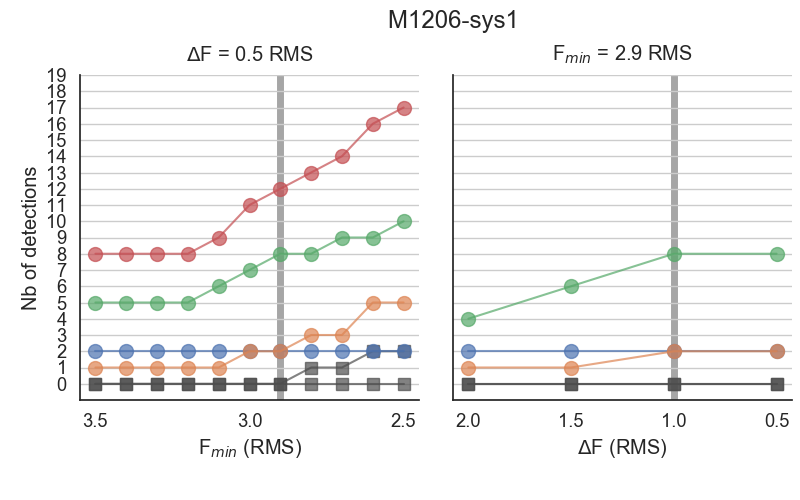

In [21]:
sns.set(font_scale=1.2)
sns.set_style('white')

fig, ax = plt.subplots(1,2,figsize=(8,5))
fig.subplots_adjust(top=0.85,bottom=0.2,left=0.1,right=0.99,wspace=0.1)
fig.suptitle('                M1206-sys1')

t = Table.read('snake_clump_detections_10kms.tab',format='ascii.fixed_width_two_line')

# Variation of Fmin, keeping Delta to 1
ax[0].set_title('$\Delta$F = 0.5 RMS',pad=10)
t_fmin = t[np.where(t['Delta']==1)]
ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps_N'],label='North image',marker='o',alpha=0.7,zorder=2,markersize=10)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps_C'],label='Centre image',marker='o',alpha=0.7,zorder=2,markersize=10)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps_S'],label='South image',marker='o',alpha=0.7,zorder=2,markersize=10)

ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps_N']+t_fmin['NbClumps_C']+t_fmin['NbClumps_S'],label='Total',marker='o',alpha=0.7,zorder=2,markersize=10)

ax[0].plot(t_fmin['Fmin'],t_fmin['NbFalse1'],label='Empty region',marker='s',alpha=0.7,color='0.3',zorder=1,markersize=8)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbFalse2'],marker='s',alpha=0.7,color='0.3',zorder=1,label='',markersize=8)

ax[0].invert_xaxis()
ax[0].set_ylabel('Nb of detections')
ax[0].set_xlabel('F$_{min}$ (RMS)')
ax[0].set_ylim(-2,21)
ax[0].axvline(2.9,linewidth=5,color='0.5',alpha=0.7,zorder=0)

# Variation of Delta, keeping Fmin to 2.9
ax[1].set_title('F$_{min}$ = 2.9 RMS',pad=10)
t_delta = t[np.where(t['Fmin']==2.9)]
t_delta.show_in_notebook()
ax[1].plot(t_delta['Delta'],t_delta['NbClumps_N'],marker='o',alpha=0.7,markersize=10)
ax[1].plot(t_delta['Delta'],t_delta['NbClumps_C'],marker='o',alpha=0.7,markersize=10)
ax[1].plot(t_delta['Delta'],t_delta['NbClumps_S'],marker='o',alpha=0.7,markersize=10)
ax[1].plot(t_delta['Delta'],t_delta['NbFalse1'],marker='s',alpha=0.7,color='0.3',markersize=8)
ax[1].plot(t_delta['Delta'],t_delta['NbFalse2'],marker='s',alpha=0.7,color='0.3',markersize=8)

ax[1].invert_xaxis()
ax[1].set_ylabel('')
ax[1].set_xlabel('$\\Delta$F (RMS)')
ax[1].axvline(1,linewidth=5,color='0.5',alpha=0.7,zorder=0)


# Set axes
sns.despine()

### Y axis is common ##
ax[0].set_ylim(-1,16)
ax[1].set_ylim(-1,16)
ax[0].yaxis.grid(True)
ax[1].yaxis.grid(True)
ax[0].set_yticks(range(0,20,1))
ax[1].set_yticks(range(0,20,1))
ax[1].set_yticklabels([''])

### X axis is common ##
ax[0].set_xticks(np.arange(3.5,2.0,-0.5))

#fig.savefig('../Plots/snake_clump_detections.jpeg')

## Final Selection

<IPython.core.display.Javascript object>


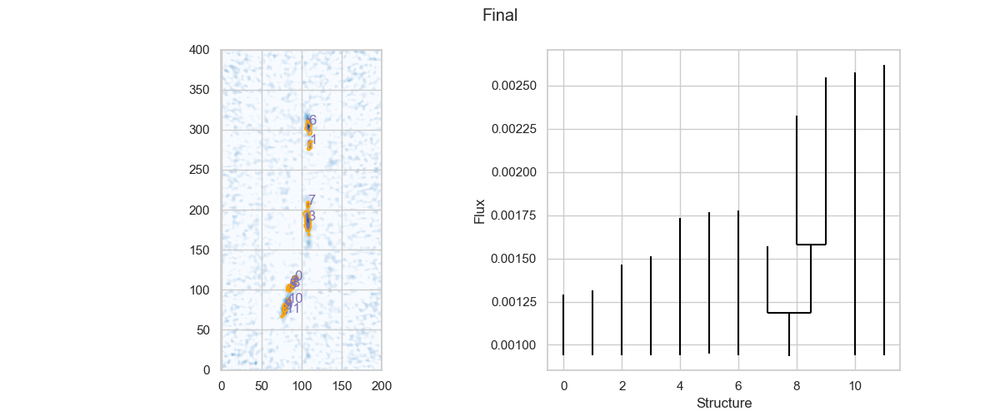

Number of leaves 12


In [17]:
d_final = Dendrogram.compute(crop_data,min_value=2.9*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_hst,min_beam_size,min_2_chan)))
d_final.save_to('snake_dendrograms_min29_delta1.fits')

p_final = d_final.plotter()
plot_to_compare(d_final,p_final,'Final',im=alma_im)
print('Number of leaves %d'%len(d_final.leaves))

cat_final = ppv_catalog(d_final.leaves, metadata,verbose=False)

Some (maybe) useful dictionaries for later

In [18]:
# Useful to order results later (idx (-> _idx ->) idx in dendro)
dendro_idx_to_hidden_idx = {}
idx_to_dendro_idx = {}
for i in range(len(cat_final)):
    dendro_idx_to_hidden_idx[i] = d_final.leaves[i].idx

idx_to_dendro_idx = {}
for k,v in dendro_idx_to_hidden_idx.items():
    idx_to_dendro_idx[int(np.squeeze(np.where(cat_final['_idx'] == v)))] = k

### Noise selection

<IPython.core.display.Javascript object>


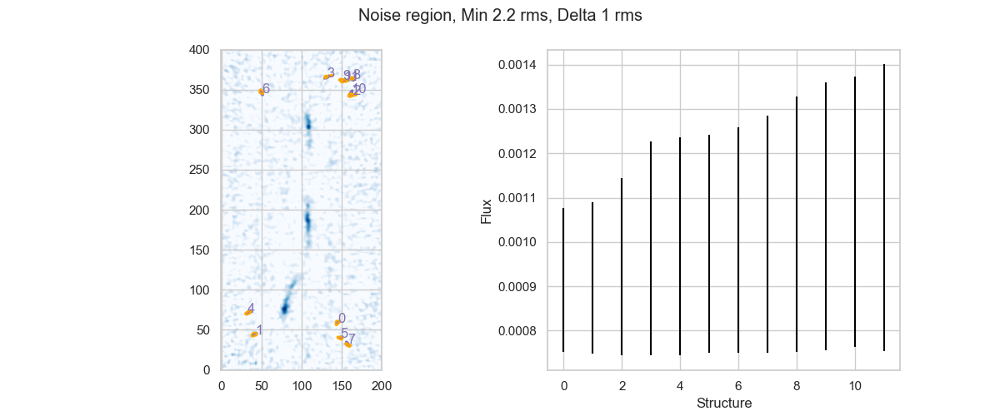

Number of leaves 12


In [19]:
d_noise = Dendrogram.compute(crop_data,min_value=2.3*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_box, min_beam_size, min_2_chan)))
p_noise = d_noise.plotter()
plot_to_compare(d_noise,p_noise,'Noise region, Min 2.2 rms, Delta 1 rms',im=alma_im)
cat_noise = ppv_catalog(d_noise.leaves, metadata=metadata,verbose=False) 
print('Number of leaves %d'%len(d_noise.leaves))

## Match Multiple images

In [20]:
def save_figure(d,p,save_dir):

    super_mask = np.zeros_like(alma_im)
    
    for nb,leaf in enumerate(d.leaves):
        mask = np.sum(leaf.get_mask(),axis=0)
        fig,ax = plt.subplots(1, 1, figsize=(5,5))
        ax.imshow(mask,origin='lower',cmap='Greys')
        plt.imshow(alma_im,origin='lower',alpha=0.7)
        p.plot_contour(ax, structure=leaf, lw=3, colors='orange')
        fits.writeto('%s/snake_clump_%d.fits'%(save_dir,leaf.idx),data=mask,header=wcs_alma.to_header(),overwrite=True)
        ax.set_title('Clump %d'%leaf.idx)
        super_mask += mask
    super_mask[np.where(super_mask ==0)] = np.nan
    return super_mask

In [25]:
def save_figure_peak(d,p,save_dir):
    
    for nb,leaf in enumerate(d.leaves):
        (index, value) = leaf.get_peak()
        print(index[1],index[2])
        fig,ax = plt.subplots(1, 2, figsize=(5,5))
        ax[0].imshow(alma_im,origin='lower',alpha=0.7)
        ax[0].plot(index[2],index[1],marker='x',color='red')
        copy = np.zeros_like(alma_im)
        copy[index[1],index[2]] = 1
        ax[1].imshow(copy,origin='lower',alpha=0.7)
        ax[1].plot(index[2],index[1],marker='x',color='red')
        fits.writeto('%s/snake_clump_peak_%d.fits'%(save_dir,leaf.idx),data=copy,header=wcs_alma.to_header(),overwrite=True)
        fig.suptitle('Clump %d'%leaf.idx)

def save_figure_ellipses(d,p,save_dir):
    
    for nb,leaf in enumerate(d.leaves):
        s = PPVStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='w', facecolor='0.8',lw=1,alpha=0.65)
        x,y = np.meshgrid(np.arange(0,alma_im.shape[1]),np.arange(0,alma_im.shape[0]))
        points = list(zip(x.flatten(),y.flatten()))
        ellipse_map = ellipse.contains_points(points,radius=0).astype(float).reshape(alma_im.shape)  
        fig,ax = plt.subplots(1, 1, figsize=(3.5,5))
        ax.imshow(alma_im,origin='lower')
        ax.imshow(ellipse_map,cmap='Reds',alpha=0.7)
        fits.writeto('%s/snake_clump_ellipse_%d.fits'%(save_dir,nb),data=ellipse_map,header=wcs_alma.to_header(),overwrite=True)


<IPython.core.display.Javascript object>


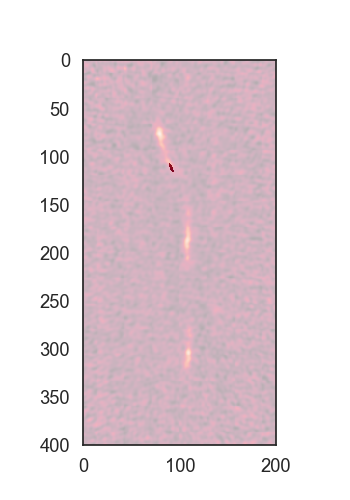

<IPython.core.display.Javascript object>


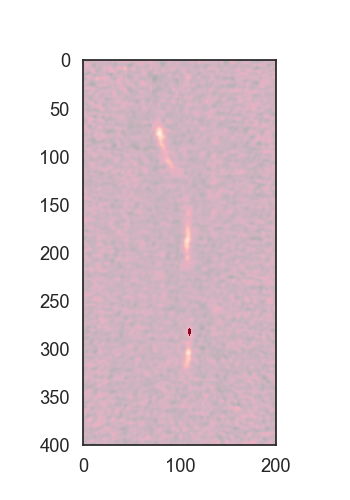

<IPython.core.display.Javascript object>


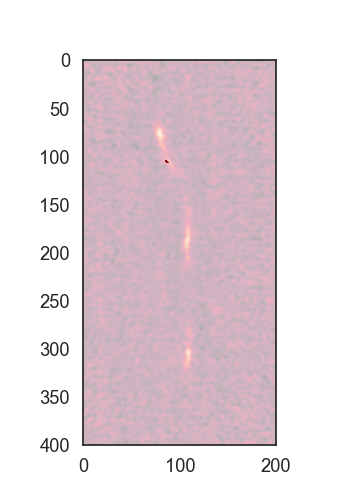

<IPython.core.display.Javascript object>


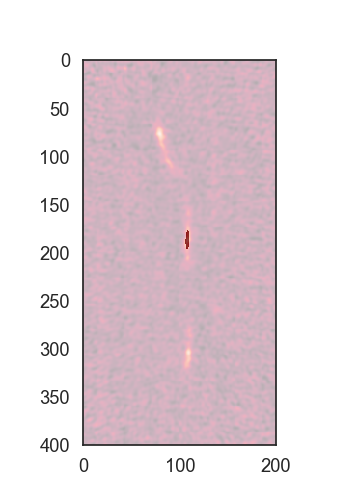

<IPython.core.display.Javascript object>


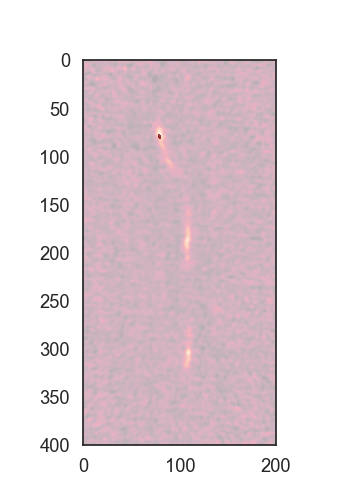

<IPython.core.display.Javascript object>


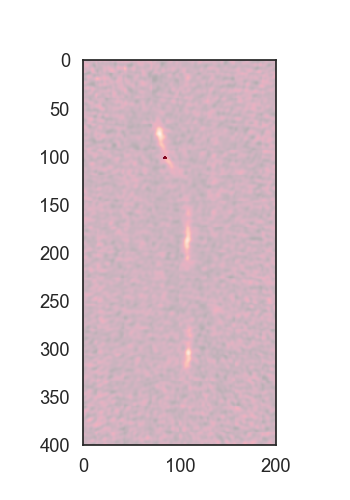

<IPython.core.display.Javascript object>


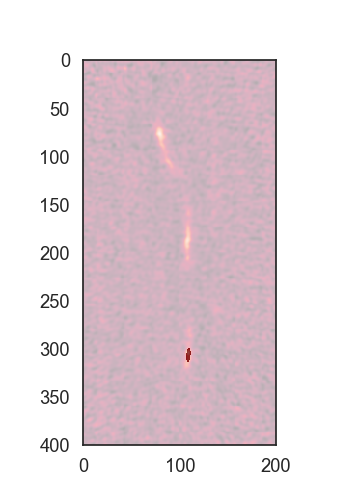

<IPython.core.display.Javascript object>


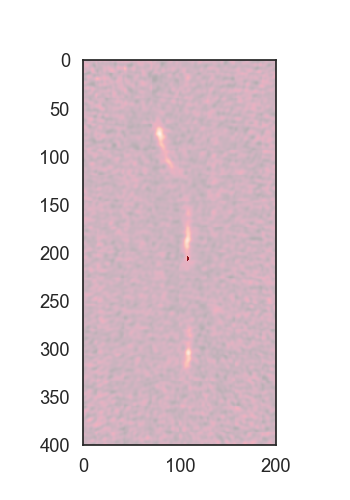

<IPython.core.display.Javascript object>


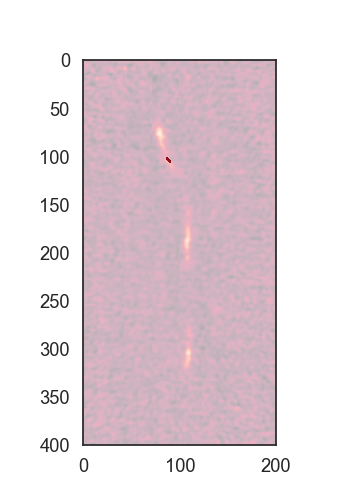

<IPython.core.display.Javascript object>


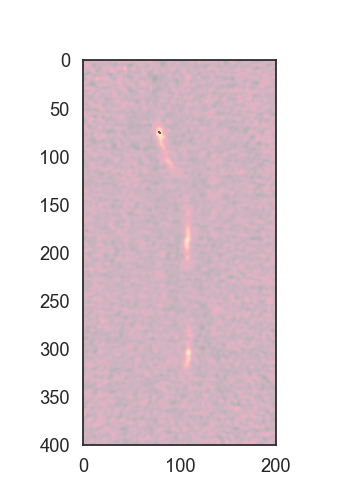

<IPython.core.display.Javascript object>


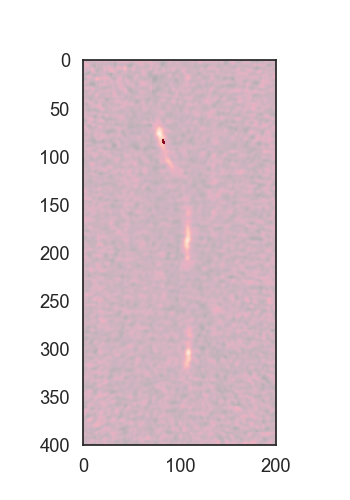

<IPython.core.display.Javascript object>


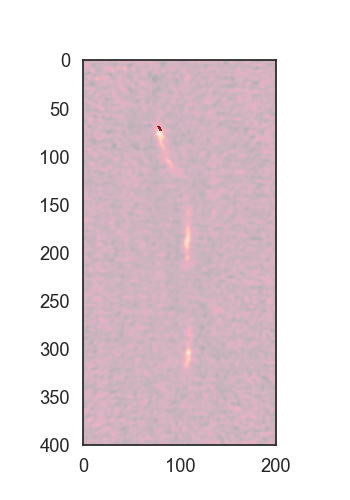

In [37]:
save_figure_ellipses(d_final,p_final,'clumps_snake/')

In [21]:
mlt_image = [which_multiple_region((c['x_cen'],c['y_cen'])) for c in cat_final]

# Test if there is some that has not been identified
for i,m in enumerate(mlt_image):
    if m==0:
        print(i,m)
        
# Save it to catalogue
col_multiple = Column(name='mlt_region', data=np.array(mlt_image))
cat_final.add_column(col_multiple)
cat_final.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,mlt_region
,,pix2,pix2,Jy,pix,pix,deg,pix,pix,pix,pix,pix,
0,0,22.88346063717193,73.0,0.16707786859478801,4.223477763740865,1.2440950303338691,68.07083721606843,2.2922494839339835,6.71971101948268,1.1062216619833722,90.83885109375043,111.44281804745042,3
1,1,20.334227416925852,77.0,0.1992814393597655,3.71387290563167,1.2571951684009663,90.99480111614282,2.1608014885720976,9.882070695731876,2.150211959927433,110.07458764328709,281.709626494907,1
2,3,8.247946916849124,27.0,0.04066003148909658,1.8477123239540556,1.0249756923135893,-153.26183506118267,1.3761759402202756,9.277152847109285,0.4475926121469191,86.2035993917559,105.0705450435455,3
3,4,58.237009994200534,288.0,1.8143553991685621,8.038321508781191,1.6635496259461973,92.55899603550668,3.656794598985322,15.042402883902902,2.4323749949852176,107.94462352158592,186.2310666195118,2
4,6,12.627134304609255,52.0,0.32061233615968376,2.4575408442501567,1.179793827182564,80.5834670799243,1.7027599707813672,15.011850635388805,2.527475011070158,79.1492317710271,79.1616363520941,3
5,7,8.421459355910649,27.0,0.03906274068867788,1.5971065746950284,1.2107529163652773,-167.94882524628565,1.3905759393352684,11.074072965544891,0.26188959757935415,84.36667762963177,101.17000034905755,3
6,8,53.24031360501313,256.0,1.608124805148691,6.656711228118438,1.836466251986046,94.07753046540168,3.4964017960835245,19.97090203287923,4.678746203839414,108.90925901073334,306.15049935649,1
7,9,7.472369016106095,26.0,0.03720136341871694,1.8773840844173206,0.9139180263400486,85.50049521130816,1.3098760082973109,12.775748173108816,0.4170886536782686,108.14668813904046,206.10894603829217,2
8,10,18.094819931528427,66.0,0.13412139122374356,3.2942543733467757,1.2612442486016386,51.0839737429558,2.0383472181682922,15.693012269177922,0.6424911274657501,87.85379194083418,103.32412567866056,3


In [22]:
print('Number of clumps identified in the north',len(cat_final[np.where(cat_final['mlt_region']==1)]))
print('Number of clumps identified in the centre',len(cat_final[np.where(cat_final['mlt_region']==2)]))
print('Number of clumps identified in the south',len(cat_final[np.where(cat_final['mlt_region']==3)]))

Number of clumps identified in the north 2
Number of clumps identified in the centre 2
Number of clumps identified in the south 8


In [26]:
print(np.where(cat_final['mlt_region']==3))

(array([ 0,  2,  4,  5,  8,  9, 10, 11]),)


In [27]:
print(np.where(cat_final['mlt_region']==1))

(array([1, 6]),)


Save each mask of the clump seperatly

### Match clumps


We do this by taking all the clumps of one of the multiple images (this case the north), lens it to source plane and then lense it back to image plane to obtain all the multiple images of that clump

<IPython.core.display.Javascript object>


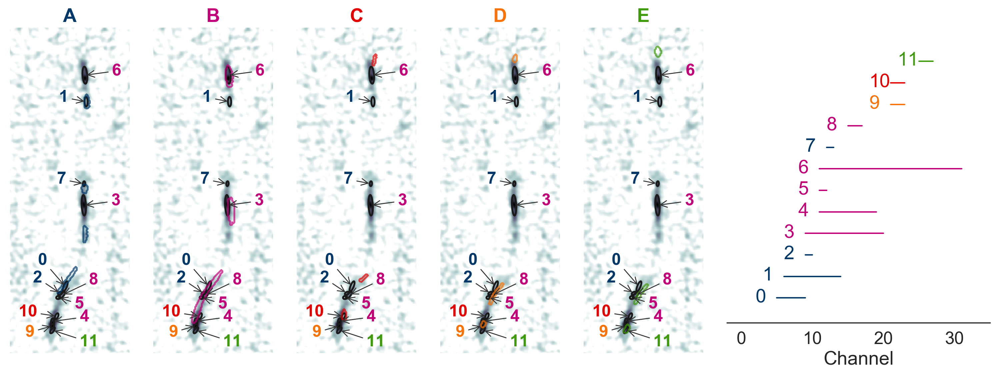

In [20]:
import glob         
import os
sns.set(font_scale=1.7)

fig, allax = plt.subplots(1,7,figsize=(15,5.5))
fig.subplots_adjust(top=0.95,bottom=0.01,left=0.01,right=0.99,hspace=0.3)


color_clump = {1:'#01386a', 7:'#01386a', 0:'#01386a',2:'#01386a',
               6:'#c20078',3:'#c20078',8:'#c20078',5:'#c20078',4:'#c20078',
               10:'#e50000',
               9:'#f97306',
               11:'#3f9b0b'}

xdisp = {1:-25,7:-25,0:-25,2:-25,10:-35,5:15,9:-25}
ydisp = {0:20,2:10,5:-10,8:10,11:-15,9:-10}

for ax in allax[:-2]:
    ax.imshow(alma_im,origin='lower',cmap='bone_r',vmin=0,vmax=0.0006)
    for clump in cat_final:
        leaf = d_final.leaves[clump.index]
        s = PPVStatistic(leaf)
        ax.add_patch(s.to_mpl_ellipse(facecolor='None',edgecolor='k',linewidth=2))
        ax.annotate('%d'%clump.index, 
                    xy=(clump['x_cen'], clump['y_cen']),
                     xytext=(clump['x_cen']+xdisp.get(clump.index,25), clump['y_cen']+ydisp.get(clump.index,0)), 
                     arrowprops=dict(arrowstyle='->',color='0.2'),
                     fontsize=18,fontweight='bold',color=color_clump.get(clump.index,'k'),
                     horizontalalignment='left')

## For each clump in the south
letter = ['A','B','C','D','E']
for n,c in enumerate([1,6,10,9,11]):
    
    ax = allax[n]
    ax.set_title(letter[n],color=color_clump.get(c,'k'),fontweight='bold')

    sp_file = '../Data/LensigStuff/MACS1206/clumps/simul_snake_clump_ellipse_'+str(c)+'.fits'
    if os.path.isfile(sp_file):
        im,_ = reproject_interp(sp_file,alma_header)
        im = crop_image(im)
        ax.contour(im,origin='lower',levels=[0.001],colors=color_clump.get(c,'k'),linewidths=2.0,linestyle='--',alpha=0.7) 

    # Prettiness
    ax.set_ylim(50,350)
    ax.set_xlim(40,150)
    ax.axis('off')
    

## Velocity
sns.set_style('white')
allax[5].remove()
allax[6].remove()
gs = allax[5].get_gridspec()
axbig = fig.add_subplot(gs[-2:])

i=0
for clump in cat_final:
    c = color_clump.get(clump.index,'k')
    leaf = d_final.leaves[clump.index]
    vmin, vmax  = np.min(leaf.indices()[0]),np.max(leaf.indices()[0])
    axbig.errorbar(x=[vmin,vmax],y=i,color=c)
    axbig.annotate(clump.index,xy=(vmin-3,i-0.2),color=c)
    i+=1

sns.despine(left=True,offset=-43)
axbig.tick_params(labelleft='off')
axbig.set_xlim(-2,35)
axbig.set_ylim(-3,13)
axbig.set_xlabel('Channel')

fig.savefig('../Plots/snake_clump_identification_vertical.jpeg')

In [23]:
clump_id = ['X' for i in range(len(cat_final)) ]
                
for i in [1,7,0,2]: 
    clump_id[i]= 'A' 
for i in [6,3,8,5,4]: 
    clump_id[i]= 'B' 
clump_id[10]='C'
clump_id[9]='D'
clump_id[11]='E'

## Estimate uncertainties

Astrodendro does not provide uncertainties. Here we will make the Fmin vary 1 RMS (-/+0.5 of the Fiducial value) and see what happens to the clumps we've identified.

When Fmin > Fmin_fiducial, some clumps will desapear, and we will not have error bars, and others will become smaller. The values we get are lower limits

When Fmin < Fmin_fiducial, we will have more clumps and our selected clumps with be bigger.

See also [Rosolowsky&Leroy 2006](https://arxiv.org/pdf/astro-ph/0601706.pdf) for bootstrapping.## Uncertainties

**Starting with Fmin = Fmin_fiducial+0.5 RMS**

In [24]:
cat_final.remove_column('mlt_region')

<IPython.core.display.Javascript object>


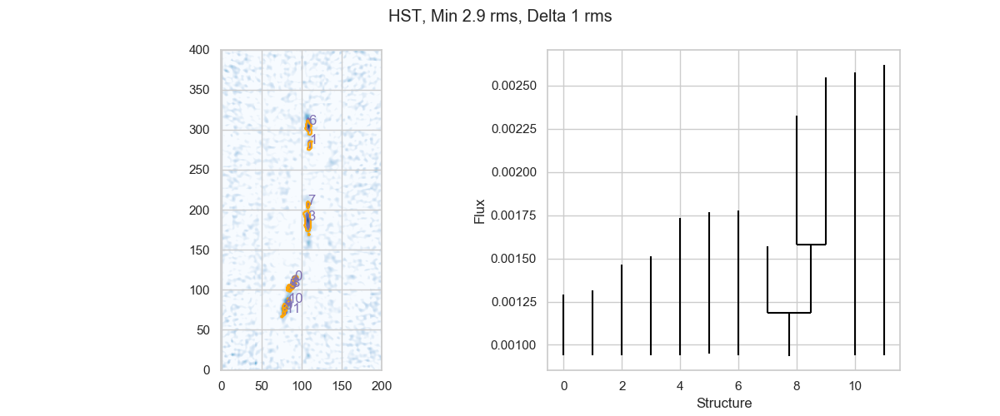

Number of clumps 12


In [25]:
plot_to_compare(d_final,p_final,'HST, Min 2.9 rms, Delta 1 rms',im=alma_im)
print('Number of clumps %d'%len(cat_final))

<IPython.core.display.Javascript object>


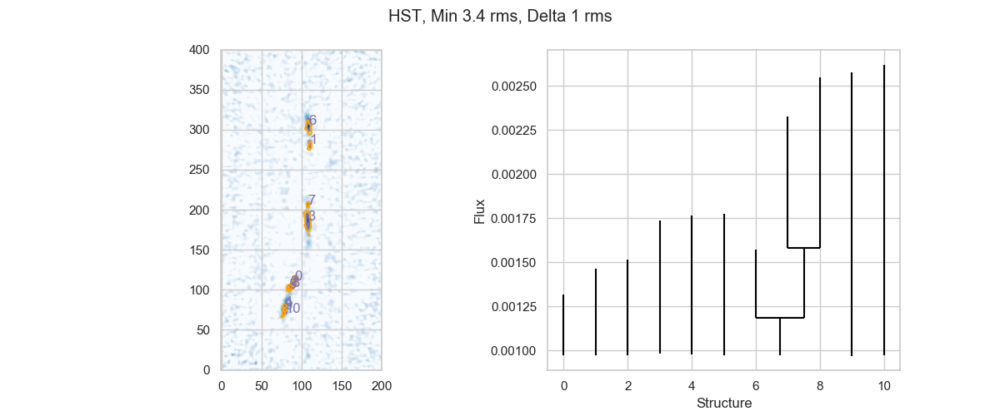

Number of clumps 11


In [26]:
d_test_max = Dendrogram.compute(crop_data,min_value=(3.0)*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_hst,min_beam_size,min_2_chan)))
p_test_max = d_test_max.plotter()
plot_to_compare(d_test_max,p_test_max,'HST, Min 3.4 rms, Delta 1 rms',im=alma_im)
cat_test_max = ppv_catalog(d_test_max.leaves, metadata,verbose=False) 
print('Number of clumps %d'%len(cat_test_max))

We lost 4 clumps. Let's put some zeros for those ones and match the remaining with the corresponding detections in the final sample.

In [27]:
def is_same_clump_2d(cat1,cat2):
    print('Cat1\tCat2\t_idx1\t_idx2\tDistance')
    new_order = []
    translate = {}
    no_match = []
    for c in cat1:
        dist = [np.sqrt((t['x_cen']- c['x_cen'])**2 + (t['y_cen']- c['y_cen'])**2) for t in cat2]
        print('%d\t%d\t%d\t%d\t%0.2f'%(c.index,np.argmin(dist),c['_idx'],cat2['_idx'][np.argmin(dist)],np.min(dist)))
        if np.min(dist) < 2.3:
            new_order.append([np.argmin(dist),c.index])
            translate[c.index] = cat2['_idx'][np.argmin(dist)]
        else:
            no_match.append(c.index)
    print('No match for ',no_match)
    return new_order,translate

In [28]:
new_order_max, translate_max = is_same_clump_2d(cat_final,cat_test_max)

Cat1	Cat2	_idx1	_idx2	Distance
0	0	0	0	0.27
1	1	1	1	0.20
2	2	3	3	0.10
3	3	4	4	0.02
4	4	6	6	0.00
5	5	7	7	0.13
6	6	8	8	0.07
7	7	9	9	0.09
8	8	10	10	0.06
9	9	11	11	0.00
10	4	12	6	6.10
11	10	13	12	0.00
No match for  [10]


In [29]:
def re_order_catalogue(cat,new_order,missing,fiducial_cat):
    
    new_order.sort(key = lambda x:x[0])
    good_order = np.transpose(new_order)[1]
    
    new_cat = cat.copy()
    new_cat.add_column(Column(name='new_idx', data=good_order),index=0)
    
    # Add missing columns
    for miss in missing:
        row = fiducial_cat[miss]
        #data_dict = {k:i for k,i in zip(row.colnames,row)} 
        data_dict = {k:0 for k,i in zip(row.colnames,row)} 
        data_dict['new_idx'] = miss
        data_dict['_idx'] = -99
        new_cat.add_row(data_dict)
            
    new_cat.sort(['new_idx'])
    new_cat.remove_column('new_idx')
    
    return new_cat

In [30]:
cat_test_max = re_order_catalogue(cat_test_max,new_order_max,[10],cat_final)

**Fmin = Fmin_fiducial-0.5 RMS**

<IPython.core.display.Javascript object>


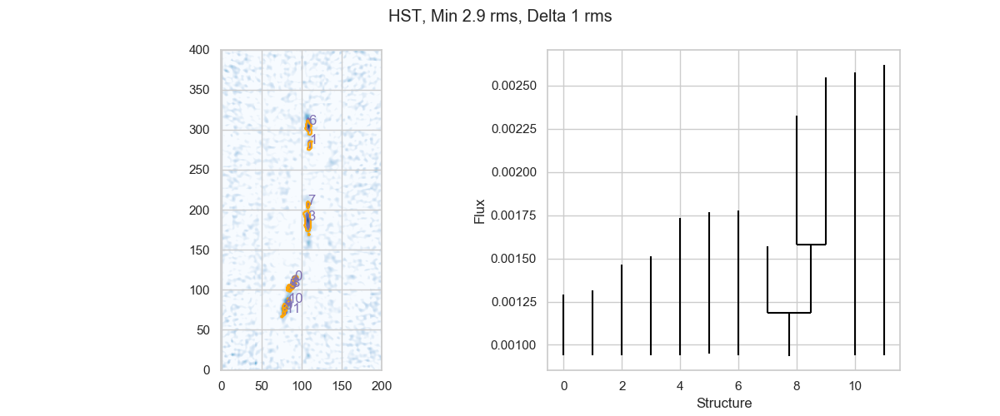

In [31]:
plot_to_compare(d_final,p_final,'HST, Min 2.9 rms, Delta 1 rms',im=alma_im)

<IPython.core.display.Javascript object>


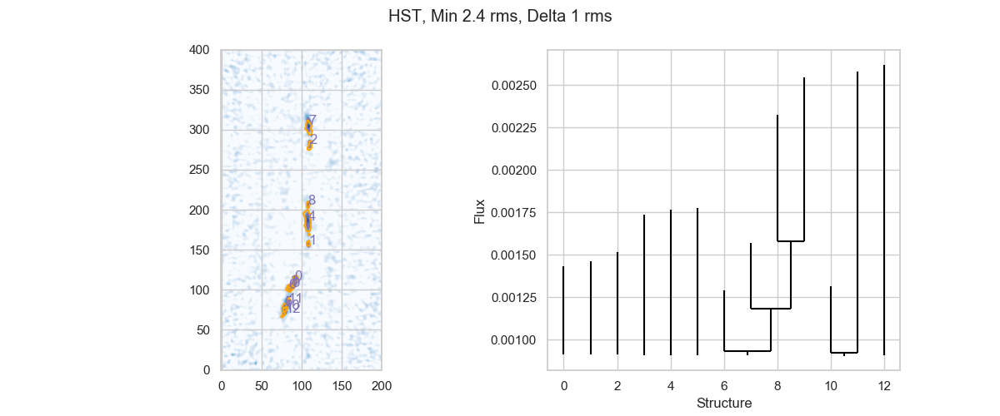

Number of clumps 13


In [32]:
d_test_min = Dendrogram.compute(crop_data,min_value=(2.8)*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_hst,min_beam_size,min_2_chan)))
p_test_min = d_test_min.plotter()
plot_to_compare(d_test_min,p_test_min,'HST, Min 2.4 rms, Delta 1 rms',im=alma_im)
cat_test_min = ppv_catalog(d_test_min.leaves, metadata,verbose=False) 
print('Number of clumps %d'%len(cat_test_min))

We got a looot more clumps. Let's see which ones are not in our final sample, and remove them.

In [33]:
test,_ = is_same_clump_2d(cat_test_min,cat_final)

Cat1	Cat2	_idx1	_idx2	Distance
0	0	0	0	0.07
1	3	1	4	30.19
2	1	2	1	0.09
3	2	5	3	0.33
4	3	6	4	0.08
5	4	9	6	0.00
6	5	10	7	0.18
7	6	11	8	0.02
8	7	12	9	0.06
9	8	13	10	0.27
10	9	14	11	0.00
11	10	15	12	0.12
12	11	16	13	0.00
No match for  [1]


In [34]:
cat_test_min.remove_rows(1)

In [35]:
new_order_min, translate_min = is_same_clump_2d(cat_final,cat_test_min)

Cat1	Cat2	_idx1	_idx2	Distance
0	0	0	0	0.07
1	1	1	2	0.09
2	2	3	5	0.33
3	3	4	6	0.08
4	4	6	9	0.00
5	5	7	10	0.18
6	6	8	11	0.02
7	7	9	12	0.06
8	8	10	13	0.27
9	9	11	14	0.00
10	10	12	15	0.12
11	11	13	16	0.00
No match for  []


In [36]:
cat_test_min = re_order_catalogue(cat_test_min,new_order_min,[],cat_final)

Some plotting

<IPython.core.display.Javascript object>


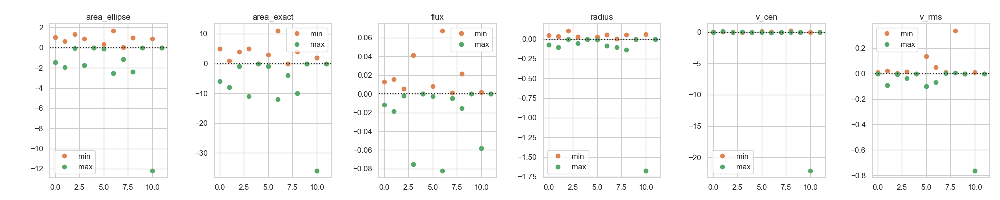

<IPython.core.display.Javascript object>


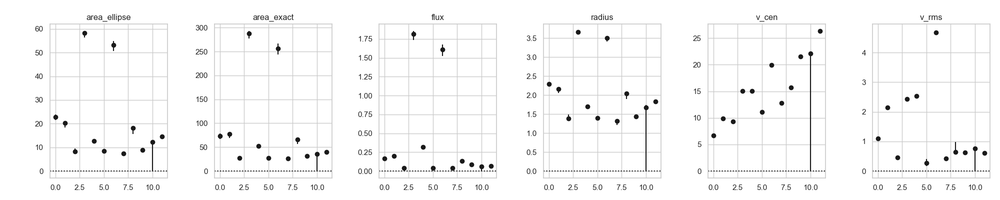

In [37]:
fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)

for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].plot(cat_test_min[col]-cat_final[col],marker='o',linestyle='',color='C1',label='min')
    ax[i].plot(cat_test_max[col]-cat_final[col],marker='o',linestyle='',color='C2',label='max')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')
    ax[i].legend()
    

fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)
for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].errorbar(x=range(len(cat_final)),y=cat_final[col],yerr=[cat_final[col]-cat_test_max[col],cat_test_min[col]-cat_final[col]],marker='o',linestyle='',color='k')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')

**Now do all again but with physical units**

And correct for beam and channel size

In [38]:
phys_metadata = {}
phys_metadata['data_unit'] = u.Jy / u.beam
phys_metadata['velocity_scale'] = 10.301829601193552 *u.km/u.second
phys_metadata['spatial_scale'] =  abs(header['CDELT1']) * u.deg 
phys_metadata['beam_major'] =  header['BMAJ'] * u.deg # FWHM for astrodendro to work
phys_metadata['beam_minor'] =  header['BMIN'] * u.deg # FWHM for astrodendro to work
phys_metadata['wcs'] = wcs_cube

In [39]:
cat_final =  ppv_catalog(d_final.leaves, phys_metadata,verbose=False) 

cat_test_max = ppv_catalog(d_test_max.leaves, phys_metadata,verbose=False)
cat_test_max = re_order_catalogue(cat_test_max,new_order_max,[10],cat_final)

cat_test_min = ppv_catalog(d_test_min.leaves, phys_metadata,verbose=False) 
cat_test_min.remove_rows([1])
cat_test_min = re_order_catalogue(cat_test_min,new_order_min,[],cat_final)

Add uncertainties

In [40]:
for col in cat_final.colnames[1:]:
    if col+'_uerr' not in cat_final.colnames:
        err_low = cat_final[col]-cat_test_max[col]
        err_up = cat_test_min[col]-cat_final[col]
        new_col1 = Column(name=col+'_uerr',data=err_up,unit=cat_final[col].unit)
        new_col2 = Column(name=col+'_lerr',data=err_low,unit=cat_final[col].unit)
        cat_final.add_columns([new_col1,new_col2])
cat_final.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,area_ellipse_uerr,area_ellipse_lerr,area_exact_uerr,area_exact_lerr,flux_uerr,flux_lerr,major_sigma_uerr,major_sigma_lerr,minor_sigma_uerr,minor_sigma_lerr,position_angle_uerr,position_angle_lerr,radius_uerr,radius_lerr,v_cen_uerr,v_cen_lerr,v_rms_uerr,v_rms_lerr,x_cen_uerr,x_cen_lerr,y_cen_uerr,y_cen_lerr
,,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg2,deg2,deg2,deg2,Jy,Jy,deg,deg,deg,deg,deg,deg,deg,deg,,,km / s,km / s,,,,
0,0,2.8251185971811544e-09,9.012345679010543e-09,0.005986405054542796,4.692753070822714e-05,1.3823278114819387e-05,68.07083721606843,2.5469438710375048e-05,226516991766.46027,11.396107062901832,181.54606068684555,-8.801206188922519,1.2573007470188427e-10,1.7789086140457315e-10,6.172839506171613e-10,7.407407407405922e-10,0.0004604300724045003,0.0004097367592278958,3.1220165286777066e-07,2.279601125047515e-06,5.197739239782985e-07,2.0908068962991043e-07,1.2173537367110612,0.19391165132383037,5.605812580010662e-07,8.149111754299675e-07,-117416.39950561523,-114566.73583984375,0.10254987654587211,0.021489287788389433,1.5962635302457784e-07,1.0375441092946858e-06,-8.087311993421054e-07,-2.819996739233943e-06
1,1,2.510398446533554e-09,9.506172839504271e-09,0.007140259963174313,4.126525450701443e-05,1.3968835204453785e-05,90.99480111614282,2.4008905428576462e-05,226492285831.4896,22.151117217620833,181.54584440464367,-8.79931433613371,8.135263093254632e-11,2.418225588199823e-10,1.234567901234326e-10,9.876543209874558e-10,0.0005621432195988514,0.000658083295791697,1.6881655873586591e-07,2.2089141312210534e-06,3.939195699755701e-07,6.316608358578976e-07,-0.570006248853872,1.2972002977852526,3.8591783423178134e-07,1.1856448860687805e-06,-203258.96279907227,1227783.8019714355,0.22735121205153064,0.9481457645942157,1.0262789373882697e-07,-5.323470304574585e-07,9.633946369547175e-07,-2.1229943278910923e-06
2,3,1.018265051462651e-09,3.3333333333326667e-09,0.001456850150599719,2.0530136932820787e-05,1.1388618803483188e-05,-153.26183506118267,1.5290843780223756e-05,226497011752.18195,4.611022821090676,181.54611280354996,-8.801276991783505,1.61696712903795e-10,8.402040935418934e-12,4.938271604937287e-10,1.2345679012343218e-10,0.00019794142374025088,6.796930874593547e-05,1.113641531036584e-06,6.053916179019001e-07,1.129438028419338e-06,-2.4920427442165483e-07,5.2309176051299175,1.0544769466807793,1.169352113740402e-06,6.321557201813819e-08,-50586.357177734375,-83390.92733764648,0.03261317309259404,0.05640403038323516,-2.639643867041741e-06,9.452001279441902e-07,2.5604350604169213e-06,-5.872626474001663e-07
3,4,7.189754320270234e-09,3.555555555554845e-08,0.06500840849641121,8.93146834308932e-05,1.8483884732733678e-05,92.55899603550668,4.063105109983285e-05,226451970736.2695,25.05791272454173,181.54586835574284,-8.800375208956948,1.1129555809570108e-10,2.1623927851747042e-10,6.172839506171613e-10,1.3580246913577535e-09,0.0014673171748110642,0.0027008381090581277,5.733088885815789e-07,1.2497842681519005e-06,1.6640999759972512e-07,3.014949272127784e-07,-0.015148302442341333,-0.0036607781865853894,3.132714550238799e-07,6.156749956294386e-07,6912.172180175781,328118.8282775879,0.16492183668653482,0.3643644914447073,-7.044161520752823e-08,1.7104420635405404e-07,8.67669355031353e-07,1.6584282391818306e-07
4,6,1.5589054697045346e-09,6.419753086418469e-09,0.011487549643034995,2.7306009380554567e-05,1.3108820302027179e-05,80.5834670799243,1.8919555230902185e-05,226452209425.711,26.037616885319554,181.5461921204154,-8.801564868270619,-2.0679515313825692e-25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.6940658945086007e-21,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.552713678800501e-15,0.0,0.0,0.0,0.0,0.0
5,7,1.0396863402356745e-09,3.3333333333326667e-09,0.0013996191732020369,1.7745628607720764e-05,1.3452810181835068e-05,-167.94882524628565,1.545084377039033e-05,226482973313.75668,2.6979420085876575,181.54613345713886,-8.801320331098697,4.0285437056208984e-11,1

Correct for beam size. There are a couple of clumps that have sizes too small

<IPython.core.display.Javascript object>


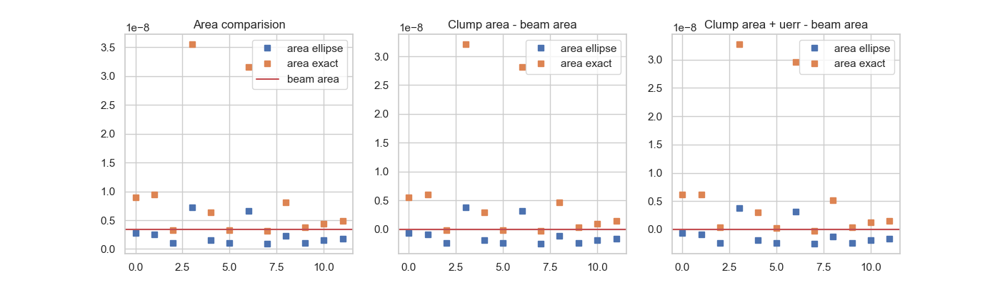

In [41]:
fig, ax = plt.subplots(1,3,figsize=(14,4))

ax[0].set_title('Area comparision')
ax[0].plot(cat_final['area_ellipse'],marker='s',linestyle='',label='area ellipse')
ax[0].plot(cat_final['area_exact'],marker='s',linestyle='',label='area exact')
ax[0].axhline(beam_area,color='r',label='beam area')
ax[0].legend()

ax[1].set_title('Clump area - beam area')
ax[1].plot(cat_final['area_ellipse']-beam_area,marker='s',linestyle='',label='area ellipse')
ax[1].plot(cat_final['area_exact']-beam_area,marker='s',linestyle='',label='area exact')
ax[1].axhline(0,color='r')
ax[1].legend()

ax[2].set_title('Clump area + uerr - beam area')
ax[2].plot(cat_final['area_ellipse']-beam_area,marker='s',linestyle='',label='area ellipse')
ax[2].plot(cat_final['area_exact']+ cat_final['area_exact_uerr']-beam_area,marker='s',linestyle='',label='area exact')
ax[2].axhline(0,color='r')
ax[2].legend()

In [42]:
def deconvolve_radius(catalogue,metadata):
    beam_area = np.pi /(4*np.log(2)) * metadata['beam_major'].value * metadata['beam_minor'].value
    corrected_area = catalogue['area_exact'] - beam_area
    corrected_radius = np.sqrt(corrected_area/np.pi)
    corrected_radius_lerr = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(corrected_area) * catalogue['area_exact_lerr']
    corrected_radius_uerr = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(corrected_area) * catalogue['area_exact_uerr']
    
    # Check if there are negative values
    not_ok = np.where(np.isnan(corrected_radius))
    corrected_area[not_ok] =catalogue['area_exact'][not_ok]
    corrected_radius[not_ok] = np.sqrt(catalogue['area_exact'][not_ok]/np.pi)
    corrected_radius_uerr[not_ok] = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(catalogue['area_exact'][not_ok]) * catalogue['area_exact_uerr'][not_ok]
    corrected_radius_lerr[not_ok] = np.sqrt(catalogue['area_exact'][not_ok]/np.pi)
    higher_limit = np.zeros_like(corrected_radius)
    higher_limit[not_ok] = 1
    
    # Old way. I think it's confusing because upper limits are not very clear
    '''if np.any(np.isnan(corrected_radius)):
        bad_radius = np.where(np.isnan(corrected_radius))
        for c in bad_radius:
            corrected_area = catalogue[c]['area_exact'] + catalogue[c]['area_exact_uerr'] - beam_area
            corrected_radius[c] = np.sqrt(corrected_area/np.pi)
            corrected_radius_lerr[c] = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(corrected_area) * catalogue[c]['area_exact_lerr']
            corrected_radius_uerr[c] = 0
    '''
    catalogue.add_column(Column(name='corrected_area', data=corrected_area, unit=u.deg**2))
    catalogue.add_column(Column(name='radius_corrected', data=corrected_radius, unit=u.deg))
    catalogue.add_column(Column(name='radius_corrected_lerr', data=corrected_radius_lerr, unit=u.deg))
    catalogue.add_column(Column(name='radius_corrected_uerr', data=corrected_radius_uerr, unit=u.deg))
    catalogue.add_column(Column(name='radius_not_corrected', data=higher_limit))

    return catalogue

In [42]:
cat_final = deconvolve_radius(cat_final,phys_metadata)

In [48]:
cat_final.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,area_ellipse_uerr,area_ellipse_lerr,area_exact_uerr,area_exact_lerr,flux_uerr,flux_lerr,major_sigma_uerr,major_sigma_lerr,minor_sigma_uerr,minor_sigma_lerr,position_angle_uerr,position_angle_lerr,radius_uerr,radius_lerr,v_cen_uerr,v_cen_lerr,v_rms_uerr,v_rms_lerr,x_cen_uerr,x_cen_lerr,y_cen_uerr,y_cen_lerr,radius_corrected,radius_corrected_lerr,radius_corrected_uerr,radius_not_corrected
,,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg2,deg2,deg2,deg2,Jy,Jy,deg,deg,deg,deg,deg,deg,deg,deg,,,km / s,km / s,,,,,deg,deg,deg,deg2
0,0,2.8251185971811544e-09,9.012345679010543e-09,0.005986405054542796,4.692753070822714e-05,1.3823278114819387e-05,68.07083721606843,2.5469438710375048e-05,226516991766.46027,11.396107062901832,181.54606068684555,-8.801206188922519,1.2573007470188427e-10,1.7789086140457315e-10,6.172839506171613e-10,7.407407407405922e-10,0.0004604300724045003,0.0004097367592278958,3.1220165286777066e-07,2.279601125047515e-06,5.197739239782985e-07,2.0908068962991043e-07,1.2173537367110612,0.19391165132383037,5.605812580010662e-07,8.149111754299675e-07,-117416.39950561523,-114566.73583984375,0.10254987654587211,0.021489287788389433,1.5962635302457784e-07,1.0375441092946858e-06,-8.087311993421054e-07,-2.819996739233943e-06,4.209456472178027e-05,2.8006596865323617e-06,2.3338830721103055e-06,0.0
1,1,2.510398446533554e-09,9.506172839504271e-09,0.007140259963174313,4.126525450701443e-05,1.3968835204453785e-05,90.99480111614282,2.4008905428576462e-05,226492285831.4896,22.151117217620833,181.54584440464367,-8.79931433613371,8.135263093254632e-11,2.418225588199823e-10,1.234567901234326e-10,9.876543209874558e-10,0.0005621432195988514,0.000658083295791697,1.6881655873586591e-07,2.2089141312210534e-06,3.939195699755701e-07,6.316608358578976e-07,-0.570006248853872,1.2972002977852526,3.8591783423178134e-07,1.1856448860687805e-06,-203258.96279907227,1227783.8019714355,0.22735121205153064,0.9481457645942157,1.0262789373882697e-07,-5.323470304574585e-07,9.633946369547175e-07,-2.1229943278910923e-06,4.392200412512356e-05,3.578845509950437e-06,4.4735568874380693e-07,0.0
2,3,1.018265051462651e-09,3.3333333333326667e-09,0.001456850150599719,2.0530136932820787e-05,1.1388618803483188e-05,-153.26183506118267,1.5290843780223756e-05,226497011752.18195,4.611022821090676,181.54611280354996,-8.801276991783505,1.61696712903795e-10,8.402040935418934e-12,4.938271604937287e-10,1.2345679012343218e-10,0.00019794142374025088,6.796930874593547e-05,1.113641531036584e-06,6.053916179019001e-07,1.129438028419338e-06,-2.4920427442165483e-07,5.2309176051299175,1.0544769466807793,1.169352113740402e-06,6.321557201813819e-08,-50586.357177734375,-83390.92733764648,0.03261317309259404,0.05640403038323516,-2.639643867041741e-06,9.452001279441902e-07,2.5604350604169213e-06,-5.872626474001663e-07,3.257350079352474e-05,3.257350079352474e-05,2.4128519106314635e-06,1.0
3,4,7.189754320270234e-09,3.555555555554845e-08,0.06500840849641121,8.93146834308932e-05,1.8483884732733678e-05,92.55899603550668,4.063105109983285e-05,226451970736.2695,25.05791272454173,181.54586835574284,-8.800375208956948,1.1129555809570108e-10,2.1623927851747042e-10,6.172839506171613e-10,1.3580246913577535e-09,0.0014673171748110642,0.0027008381090581277,5.733088885815789e-07,1.2497842681519005e-06,1.6640999759972512e-07,3.014949272127784e-07,-0.015148302442341333,-0.0036607781865853894,3.132714550238799e-07,6.156749956294386e-07,6912.172180175781,328118.8282775879,0.16492183668653482,0.3643644914447073,-7.044161520752823e-08,1.7104420635405404e-07,8.67669355031353e-07,1.6584282391818306e-07,0.00010109855831746266,2.1378775925937116e-06,9.717625420880516e-07,0.0
4,6,1.5589054697045346e-09,6.419753086418469e-09,0.011487549643034995,2.7306009380554567e-05,1.3108820302027179e-05,80.5834670799243,1.8919555230902185e-05,226452209425.711,26.037616885319554,181.5461921204154,-8.801564868270619,-2.0679515313825692e-

<IPython.core.display.Javascript object>


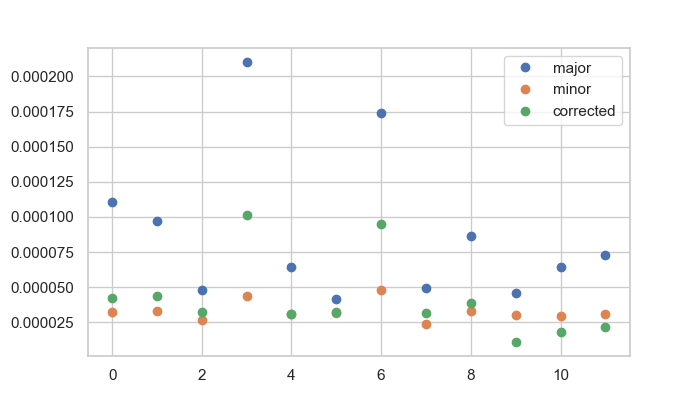

In [43]:
fig, ax = plt.subplots(1,1,figsize=(7,4))
ax.plot(cat_final['major_sigma']* 2.3548,marker='o',linestyle='',label='major')
ax.plot(cat_final['minor_sigma']* 2.3548,marker='o',linestyle='',label='minor')
ax.plot(cat_final['radius_corrected'],marker='o',linestyle='',label='corrected')
plt.legend()

### Extract spectra from clumps and fit line width

In [43]:
from astropy.modeling import models,fitting
sns.set_style('whitegrid')

def fit_with_gaussian(leaf,sp,xaxis,plot=True):
    xaxis = range(len(sp))
    g = models.Gaussian1D(amplitude=0.1, mean=leaf.get_peak()[0][0], stddev=5)
    fit = fitting.LevMarLSQFitter()
    fit_g = fit(g, xaxis, sp)
    if plot:
        ax[n].plot(fit_g(xaxis),color='red',linewidth=1.5,label='fit',linestyle=':')
    std = fit_g.stddev.value*phys_metadata['velocity_scale']
    return std.value    
    
def extract_spectrum(im_mask):
    sp = 0
    qq, pp = np.where(im_mask)
    for (p,q)in zip(qq,pp):
        sp += crop_data[:,p,q]
    xaxis = range(len(sp))*phys_metadata['velocity_scale']
    return sp, xaxis

def deconvolve_channel(width):
    return np.sqrt(width**2 - phys_metadata['velocity_scale'].value**2/(2*np.pi))

<IPython.core.display.Javascript object>


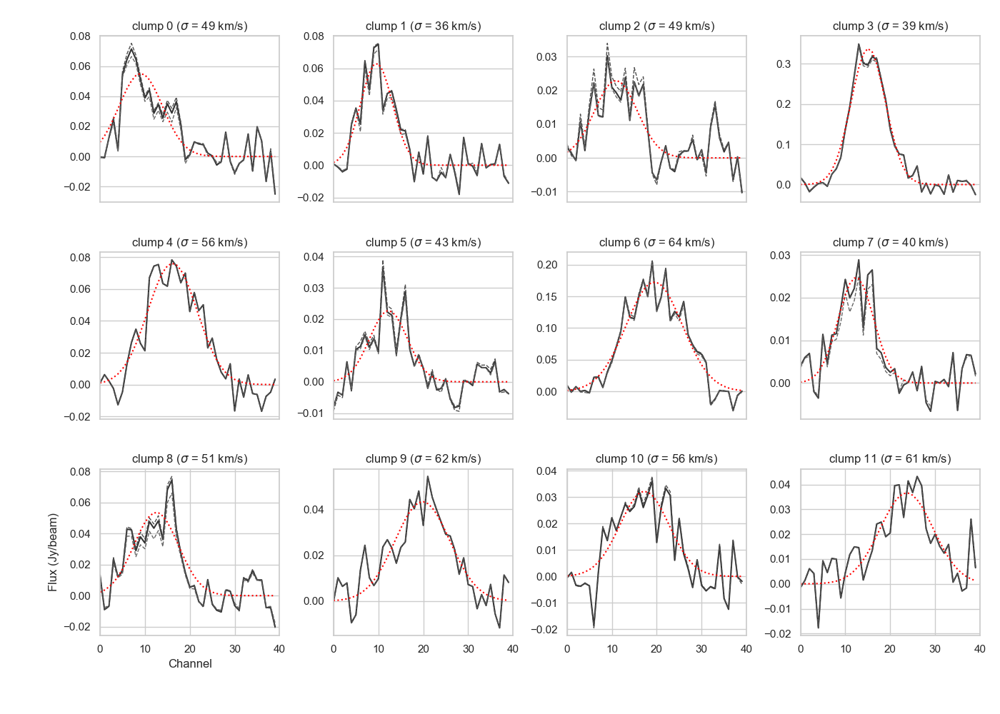

no clump for max
[49.627359683570134, 36.259199484188194, 48.8886208110508, 39.27365343443875, 56.61044442502862, 43.19783121601076, 64.27569363080086, 40.606686447467496, 50.85941330935636, 62.824413216957545, 56.053796253673795, 60.90083269417925]
[2.3494275130355717, 0.18582711555859888, 0.5687467006607569, 0.022188945448252895, 0.0, 0.061343224006904506, 0.2892217359544489, 0.08605487184481575, 0.34509302931192565, 0.0, 28.11313123594874, 0.0]


In [44]:
bg_spec = np.nanmean(crop_data[:,280:340,190:240],axis=(1,2))
fig, ax = plt.subplots(3,4,figsize=(14,10))
fig.subplots_adjust(top=0.95,left=0.1,right=0.98,hspace=0.3,wspace=0.3)
ax = ax.ravel()
width = []
width_channel_corrected = []
width_unc = []

from_n_to_idx_max = {l.idx:n for n,l in enumerate(d_test_max.leaves)}
from_n_to_idx_min = {l.idx:n for n,l in enumerate(d_test_min.leaves)}
    
for n in range(len(cat_final)):
    
    leaf = d_final.leaves[idx_to_dendro_idx[n]]
    
    # spectrum from final selection
    im_mask = np.nansum(leaf.get_mask(),axis=0)
    im_mask[im_mask >0] = 1
    sp, xaxis = extract_spectrum(im_mask)
    ax[n].plot(sp,color='0.2',linewidth=1.5,label='data')
   
    # Spectrum from Fmin+0.5rms
    hidden_idx_max = translate_max.get(n,None) # n to _idx
    n_max = from_n_to_idx_max.get(hidden_idx_max,None) # _idx to position
    if n_max is None:
        print('no clump for max')
        std_max = 0
    else:
        leaf_max = d_test_max.leaves[n_max]
        im_mask_max = np.nansum(leaf_max.get_mask(),axis=0)
        sp_max,_ = extract_spectrum(im_mask_max)
        ax[n].plot(sp_max,color='0.4',linewidth=1.,linestyle='--',label='+ 0.5 RMS')
        std_max = fit_with_gaussian(leaf_max,sp_max,xaxis,plot=False)
    
    # Spectrum from Fmin-0.5rms
    hidden_idx_min = translate_min.get(n,None) # n to _idx
    n_min = from_n_to_idx_min.get(hidden_idx_min,None) # _idx to position
    if n_min is None:
        print('no clump for min')
        std_min = 0
    else:
        leaf_min = d_test_min.leaves[n_min]
        im_mask_min = np.nansum(leaf_min.get_mask(),axis=0)
        sp_min,_ = extract_spectrum(im_mask_min)
        ax[n].plot(sp_min,color='0.3',linewidth=1.,linestyle='--',label='data -0.5 RMS')
        std_min = fit_with_gaussian(leaf_min,sp_min,xaxis,plot=False)
    
    # Fit with Gaussian
    std = fit_with_gaussian(leaf,sp,xaxis)
    ax[n].set_title('clump %d ($\sigma$ = %d km/s)'%(n,std))
    
    #print('%0.2f + %0.2f - %0.2f'%(std,std_min,std_max))
    width.append(std)
    width_channel_corrected.append(deconvolve_channel(std))
    width_unc.append(np.mean((abs(std-std_min),abs(std-std_max))))

    ax[n].set_xlim(0,40)

ax[8].set_ylabel('Flux (Jy/beam)')
ax[8].set_xlabel('Channel')

for x in ax[:8]:
    x.get_xaxis().set_ticks([])
    
print(width_channel_corrected)
print(width_unc)

fig.savefig('../Plots/snake_spectra.jpeg')

Add this to final catalogue

In [45]:
cat_final.add_column(Column(name='measured_line_width', data=width, unit='km/s'))
cat_final.add_column(Column(name='line_width', data=width_channel_corrected, unit='km/s'))
cat_final.add_column(Column(name='line_width_unc', data=width_unc, unit='km/s'))

cat_final.add_column(col_multiple)

In [47]:
cat_final.write('snake_catalogue.txt',format='ascii.fixed_width_two_line')
cat_final.write('snake_catalogue.fits')

### Noise properties

In [46]:
def deconvolve_radius_noise(catalogue,metadata):
    beam_area = np.pi /(4*np.log(2)) * metadata['beam_major'].value * metadata['beam_minor'].value
    corrected_area = catalogue['area_exact'] - beam_area
    corrected_radius = np.sqrt(corrected_area/np.pi)
    
    ## Test the ones that are smaller than the area
    not_ok = np.where(np.isnan(corrected_radius))
    corrected_area[not_ok] =catalogue['area_exact'][not_ok]
    higher_limit = np.zeros_like(corrected_radius)
    higher_limit[not_ok] = 1 
    corrected_radius[not_ok] = np.sqrt(catalogue['area_exact']/np.pi)[not_ok]
    
    catalogue.add_column(Column(name='corrected_area', data=corrected_area, unit=u.deg))
    catalogue.add_column(Column(name='radius_corrected', data=corrected_radius, unit=u.deg))
    catalogue.add_column(Column(name='radius_not_corrected', data=higher_limit))

    return catalogue

In [47]:
cat_noise =  ppv_catalog(d_noise.leaves, phys_metadata,verbose=False) 
cat_noise = deconvolve_radius_noise(cat_noise,phys_metadata)
cat_noise.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,corrected_area,radius_corrected,radius_not_corrected
,,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg,deg,deg2
0,0,1.0911349141048764e-09,2.9629629629623706e-09,0.0009219211722603123,2.0041430457543247e-05,1.2501202807585529e-05,-150.7398484492165,1.5828518146177482e-05,226547378077.5786,3.867321392402813,181.54544990402454,-8.801787927772462,2.9629629629623706e-09,3.0710591064115636e-05,1.0
1,1,1.4641948352079057e-09,4.1975308641966915e-09,0.0014309550109091775,2.6300381079709193e-05,1.278317968887575e-05,-147.4259434426121,1.833582551258139e-05,226501576593.09763,4.75234508992079,181.54661206805176,-8.801948813783376,7.519377619283951e-10,1.5470915403321218e-05,0.0
2,2,1.3127682603743767e-09,3.827160493826395e-09,0.0010841197666007852,3.101216287747558e-05,9.71981672597745e-06,-174.8798039881665,1.7361812677402785e-05,226467107093.89676,3.1573854412900113,181.54523888564512,-8.798630872597,3.81567391558099e-10,1.102073831366594e-05,0.0
3,3,1.7518735856163896e-09,3.2098765432092345e-09,0.0008950180393892508,3.5348196582416924e-05,1.1379876980677584e-05,-154.91822114490333,2.0056373764883632e-05,226448598530.88052,7.366403139659446,181.54560278572825,-8.798384448257414,3.2098765432092345e-09,3.196459662083898e-05,1.0
4,4,1.1727822281168774e-09,3.456790123456099e-09,0.0010585197284549313,2.4048870475921546e-05,1.119759504114313e-05,-161.46524621896523,1.6410043046447883e-05,226422767324.89084,4.2644306877708535,181.54671233812573,-8.801651509445847,1.1197021187802495e-11,1.8878883812044888e-06,0.0
5,5,1.0464755070391497e-09,2.9629629629623706e-09,0.0008503400667895244,2.0285456280663344e-05,1.1845307836324258e-05,178.6772689725048,1.550120879946963e-05,226372556804.44586,4.1767172006118995,181.5454102440612,-8.801998133377504,2.9629629629623706e-09,3.0710591064115636e-05,1.0
6,6,1.328715866223465e-09,4.1975308641966915e-09,0.0013105611972228527,2.7690259465043503e-05,1.1018111426415937e-05,115.39132105120666,1.7466950627176395e-05,226369624853.6663,5.080010722767465,181.54651385987302,-8.798605479880527,7.519377619283951e-10,1.5470915403321218e-05,0.0
7,7,1.5314014484736925e-09,3.950617283949827e-09,0.0011842344839400293,2.9334387701509054e-05,1.1987098949446634e-05,123.75231743386324,1.8751912115819533e-05,226354219280.10373,7.267987989055278,181.545314504729,-8.802081505209369,5.050241816815308e-10,1.2678887561261442e-05,0.0
8,8,1.1230116512411636e-09,3.456790123456099e-09,0.0011331704981462547,2.0791426812344434e-05,1.2402294297116895e-05,146.38483529909018,1.6058063213963965e-05,226314937259.75052,5.07998995815615,181.54524157265024,-8.7984144453692,1.1197021187802495e-11,1.8878883812044888e-06,0.0


Spectra

<IPython.core.display.Javascript object>


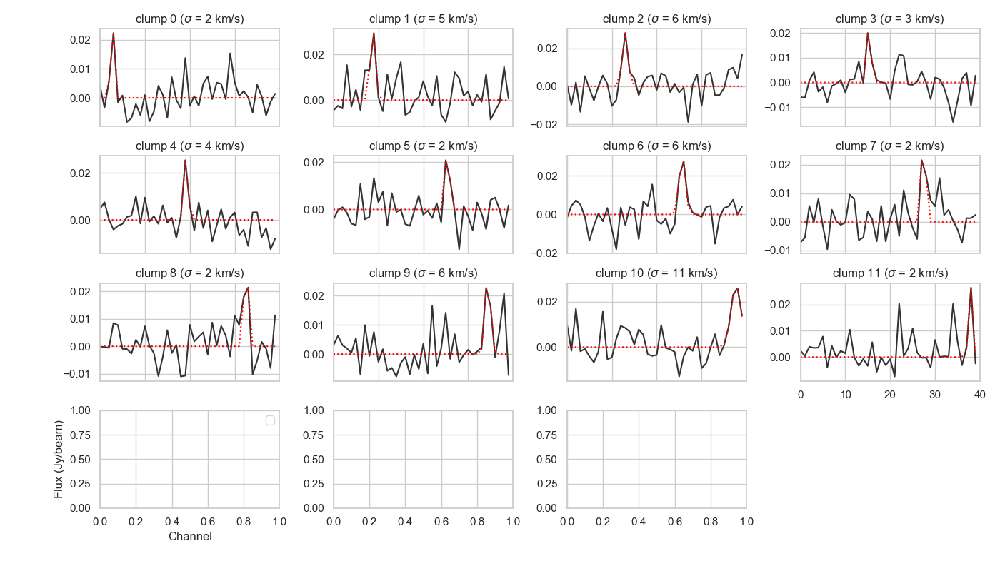

No handles with labels found to put in legend.


In [48]:
bg_spec = np.nanmean(crop_data[:,280:340,190:240],axis=(1,2))
fig, ax = plt.subplots(4,4,figsize=(14,8))
fig.subplots_adjust(top=0.95,left=0.1,right=0.98,hspace=0.3,wspace=0.3)
ax = ax.ravel()
width_noise = []
width_channel_corrected_noise = []


def fit_with_gaussian(leaf,sp,xaxis,plot=True):
    xaxis = range(len(sp))
    g = models.Gaussian1D(amplitude=0.02, mean=leaf.get_peak()[0][0], stddev=1)
    fit = fitting.LevMarLSQFitter()
    fit_g = fit(g, xaxis, sp)
    if plot:
        ax[n].plot(fit_g(xaxis),color='red',linewidth=1.5,label='fit',linestyle=':')
    std = fit_g.stddev.value*phys_metadata['velocity_scale']
    return std.value
    
    
for leaf in d_noise.leaves: # there is no hierarchical structure, so the order is simpler
        
    n = leaf.idx
    
    # spectrum from final selection
    im_mask = np.nansum(leaf.get_mask(),axis=0)
    im_mask[im_mask >0] = 1
    sp, xaxis = extract_spectrum(im_mask)
    ax[n].plot(sp,color='0.2',linewidth=1.5,label='data')
    
    # Fit with Gaussian
    std = fit_with_gaussian(leaf,sp,xaxis)
    ax[n].set_title('clump %d ($\sigma$ = %d km/s)'%(n,std))
    
    width_noise.append(std)
    width_channel_corrected_noise.append(deconvolve_channel(std))

    ax[n].set_xlim(0,40)
    
ax[12].legend()
ax[12].set_ylabel('Flux (Jy/beam)')
ax[12].set_xlabel('Channel')
ax[15].axis('off')

for x in ax[:11]:
    x.set_xticklabels([])
    
fig.savefig('../Plots/snake_noise_spectra.jpeg')

Add to catalogue

In [51]:
width_channel_corrected_noise = np.array(width_channel_corrected_noise)
width_noise = np.array(width_noise)

## Test the line width that are smaller than the channel width
not_ok = np.where(np.isnan(width_channel_corrected_noise))[0]
higher_limit = np.zeros_like(width_channel_corrected_noise)
higher_limit[not_ok] = 1 
width_channel_corrected_noise[not_ok] = width_noise[not_ok]

cat_noise.add_column(Column(name='line_width', data=width_channel_corrected_noise, unit='km/s'))
cat_noise.add_column(Column(name='line_width_not_corrected', data=higher_limit))

cat_noise.write('snake_noise_catalogue.fits',overwrite=True)

## Smaller catalogue

In [48]:
keeping_columns = ['_idx','mlt_region',
                   'flux', 'flux_lerr','flux_uerr',
                   'radius_corrected', 'radius_corrected_lerr','radius_corrected_uerr', 'radius_not_corrected', # radius corrected for beam size (mostly nans)
                    'corrected_area','area_exact_lerr','area_exact_uerr',
                   'line_width','line_width_unc'] # line width sigma corrected for channel width
    
cat_small = cat_final[keeping_columns]

In [49]:
cat_small.write('snake_small_catalogue.fits')

In [59]:
cat_small.show_in_notebook()

idx,_idx,mlt_region,flux,flux_lerr,flux_uerr,radius_corrected,radius_corrected_lerr,radius_corrected_uerr,radius_not_corrected,line_width,line_width_unc
,,,Jy,Jy,Jy,deg,deg,deg,deg2,km / s,km / s
0,0,3,0.005986405054542796,0.002681359874205773,0.002155016827090399,4.209456472178027e-05,1.9604617805726537e-05,9.802308902863272e-06,0.0,49.627359683570134,14.182692386290558
1,1,1,0.007140259963174313,0.0036444865517481113,0.0018835027190872789,4.392200412512356e-05,1.1631247907338932e-05,7.605046708644687e-06,0.0,36.259199484188194,2.448622493842734
2,3,3,0.001456850150599719,0.001456850150599719,0.0006373806635744,3.257350079352474e-05,3.257350079352474e-05,8.444981687210118e-06,1.0,48.8886208110508,25.45080411371598
3,4,2,0.06500840849641121,0.01576220667311603,0.0014673171748110642,0.00010109855831746266,1.574255318182642e-05,9.717625420880516e-07,0.0,39.27365343443875,0.2120800998317769
4,6,3,0.011487549643034995,0.0,0.0,3.0768563925656755e-05,0.0,0.0,0.0,56.61044442502862,0.0
5,7,3,0.0013996191732020369,0.0013996191732020369,0.0005459041546636268,3.257350079352474e-05,3.257350079352474e-05,3.619277865947191e-06,1.0,43.19783121601076,21.727263876605495
6,8,1,0.0576191601128558,0.012734178117541906,0.006894561596745841,9.467522355854044e-05,1.328246705678201e-05,7.471387719439879e-06,0.0,64.27569363080086,2.022828942818915
7,9,2,0.0013329259696615362,0.0013329259696615362,3.353456904083094e-05,3.196459662083898e-05,3.196459662083898e-05,0.0,1.0,40.606686447467496,20.40706820689735
8,10,3,0.004805573479581584,0.0016553302155796162,0.0014782234393268976,3.8689401151045326e-05,1.1172896764497593e-05,6.6021662699304034e-06,0.0,50.85941330935636,0.8546446662861662


**Noise**

In [54]:
cat_noise_small = cat_noise['_idx','flux','radius_corrected','radius_not_corrected','corrected_area','line_width','line_width_not_corrected']
cat_noise_small.write('snake_noise_small_catalogue.fits',overwrite=True)
cat_noise_small.show_in_notebook()

idx,_idx,flux,radius_corrected,radius_not_corrected,corrected_area,line_width,line_width_not_corrected
,,Jy,deg,deg2,deg,km / s,
0,0,0.0009219211722603123,3.0710591064115636e-05,1.0,2.9629629629623706e-09,2.7416621531492398,1.0
1,1,0.0014309550109091775,1.5470915403321218e-05,0.0,7.519377619283951e-10,4.053131777032555,0.0
2,2,0.0010841197666007852,1.102073831366594e-05,0.0,3.81567391558099e-10,5.0588626007735495,0.0
3,3,0.0008950180393892508,3.196459662083898e-05,1.0,3.2098765432092345e-09,3.024696296864116,1.0
4,4,0.0010585197284549313,1.8878883812044888e-06,0.0,1.1197021187802495e-11,2.733591780864355,0.0
5,5,0.0008503400667895244,3.0710591064115636e-05,1.0,2.9629629629623706e-09,2.5966877585843813,1.0
6,6,0.0013105611972228527,1.5470915403321218e-05,0.0,7.519377619283951e-10,5.548396285653327,0.0
7,7,0.0011842344839400293,1.2678887561261442e-05,0.0,5.050241816815308e-10,2.6627642357215158,1.0
8,8,0.0011331704981462547,1.8878883812044888e-06,0.0,1.1197021187802495e-11,2.7427752843541464,1.0


# Older stuff

Correct for beam size

In [45]:
def deconvolve_sigma(catalogue,metadata):
    beam = np.mean((metadata['beam_major'].value,metadata['beam_minor'].value))
    corrected = np.sqrt(np.sqrt(catalogue['major_sigma']**2 - beam**2)*np.sqrt(catalogue['minor_sigma']**2 - beam**2))        
    catalogue.add_column(Column(name='sigma', data=corrected, unit=u.deg))
    return catalogue
                        
cat_final = deconvolve_sigma(cat_final,phys_metadata)
cat_test_max = deconvolve_sigma(cat_test_max,phys_metadata)
cat_test_min = deconvolve_sigma(cat_test_min,phys_metadata)

Correct for Channel width

In [46]:
def deconvolve_channel(catalogue,metadata):
    sigma_deconv = np.sqrt(catalogue['v_rms']**2 - metadata['velocity_scale'].value**2/(2*np.pi))
    catalogue.add_column(Column(name='v_sigma', data=sigma_deconv, unit=u.km/u.second))
    fwhm = np.sqrt(8*np.log(2))*sigma_deconv
    catalogue.add_column(Column(name='v_FWHM', data=fwhm, unit=u.km/u.second))
    return catalogue

cat_final = deconvolve_channel(cat_final,phys_metadata)
cat_test_max = deconvolve_channel(cat_test_max,phys_metadata)
cat_test_min = deconvolve_channel(cat_test_min,phys_metadata)

Combine, add clump id and mlt and save results

<IPython.core.display.Javascript object>


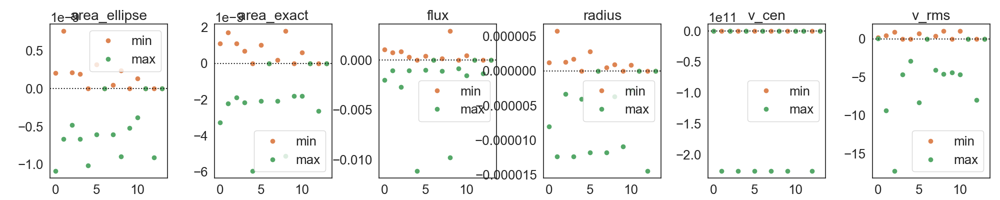

<IPython.core.display.Javascript object>


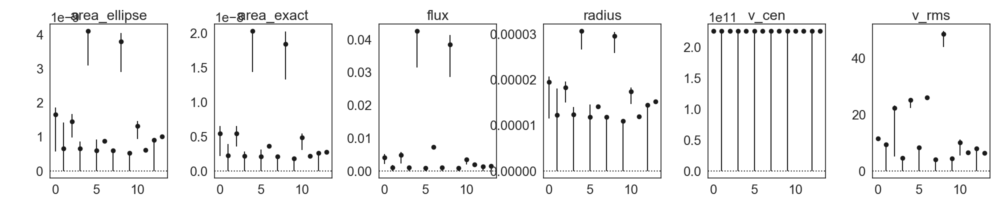

In [47]:
fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)

for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].plot(cat_test_min[col]-cat_final[col],marker='o',linestyle='',color='C1',label='min')
    ax[i].plot(cat_test_max[col]-cat_final[col],marker='o',linestyle='',color='C2',label='max')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')
    ax[i].legend()
    

fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)
for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].errorbar(x=range(len(cat_final)),y=cat_final[col],yerr=[cat_final[col]-cat_test_max[col],cat_test_min[col]-cat_final[col]],marker='o',linestyle='',color='k')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')

Combine, add clump id and mlt, and save the results

In [48]:
for col in cat_final.colnames[1:]:
    err_up = cat_final[col]-cat_test_max[col]
    new_col1 = Column(name=col+'_uerr',data=err_up,unit=cat_final[col].unit)
    err_down = cat_test_min[col]-cat_final[col]
    new_col2 = Column(name=col+'_derr',data=err_down,unit=cat_final[col].unit)
    cat_final.add_columns([new_col1,new_col2])
    
cat_final.add_column(col_multiple,index=1)    
cat_final.add_column(Column(clump_id,name='clump_id'),index=2)    
    
cat_final.show_in_notebook()

idx,_idx,mlt_region,clump_id,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,sigma,v_sigma,v_FWHM,area_ellipse_uerr,area_ellipse_derr,area_exact_uerr,area_exact_derr,flux_uerr,flux_derr,major_sigma_uerr,major_sigma_derr,minor_sigma_uerr,minor_sigma_derr,position_angle_uerr,position_angle_derr,radius_uerr,radius_derr,v_cen_uerr,v_cen_derr,v_rms_uerr,v_rms_derr,x_cen_uerr,x_cen_derr,y_cen_uerr,y_cen_derr,sigma_uerr,sigma_derr,v_sigma_uerr,v_sigma_derr,v_FWHM_uerr,v_FWHM_derr
,,,,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg,km / s,km / s,deg2,deg2,deg2,deg2,Jy,Jy,deg,deg,deg,deg,deg,deg,deg,deg,,,km / s,km / s,,,,,deg,deg,km / s,km / s,km / s,km / s
0,0,3,B,1.6598523779344083e-09,5.416666666666233e-09,0.004130174584916899,3.542979927082331e-05,1.0757289029098908e-05,69.28819095277949,1.9522514976283256e-05,226516874350.06076,11.496614782153799,181.5460608464719,-8.801206997653718,nan,10.73719719184751,25.284167174812538,1.0877517419141923e-09,2.0840007217783806e-10,3.2638888888886276e-09,1.1111111111110224e-09,0.0020127924373927073,0.0010677960569268992,2.155107380167387e-05,3.1438747726854344e-07,1.292195501233382e-06,1.2441190845864863e-06,8.186318350433318,-0.7930830984165311,8.061126115718896e-06,1.1893312199310142e-06,1294600.9552612305,-14296.923645019531,-0.04719902077728477,0.2092407419586717,8.296804622887066e-06,5.271417364838271e-07,-2.3915429370191532e-05,-9.64727089325379e-07,nan,nan,-0.05052217807137005,0.22374736775935133,-0.11897063764108395,0.5268847866226309
1,1,2,B,6.624887564344335e-10,2.2222222222220443e-09,0.0010312114687883924,1.72297685090976e-05,8.828788920502513e-06,97.78261173876164,1.2333612176323042e-05,226513601512.44858,9.364720655988235,181.5458599693117,-8.8007105478374,nan,8.415060608936429,19.81595340207385,6.624887564344335e-10,7.626001087545976e-10,2.2222222222220443e-09,1.7361111111109721e-09,0.0010312114687883924,0.0007755544870555943,1.72297685090976e-05,1.2431803649671353e-05,8.828788920502513e-06,2.2030990986220704e-06,97.78261173876164,-6.127429796245281,1.2333612176323042e-05,5.755697996448129e-06,226513601512.44858,-1091147.7584228516,9.364720655988235,0.41454202037505716,181.5458599693117,-2.8564555520915746e-06,-8.8007105478374,9.50849100611606e-06,nan,nan,nan,0.459015713740369,nan,1.080899403700009
2,2,1,B,1.457859981074856e-09,5.416666666666233e-09,0.004934556141400268,3.1075553299314585e-05,1.0772066080822662e-05,90.42479486728895,1.8296117447107282e-05,226492082572.5268,22.374494021811447,181.54584450727157,-8.799313372739073,nan,21.993936319346226,51.79176211393071,4.789479164923529e-10,2.1203020684603813e-10,1.8749999999998497e-09,1.1111111111110224e-09,0.002694983666814975,0.0008465309434568758,7.032929727016288e-06,1.643158546782268e-06,1.4230934480576685e-06,9.470209706953573e-07,4.409514368913278,1.0882922788299396,3.3036583493712704e-06,1.285338891427472e-06,-3534017.558380127,-309534.6596069336,17.244716726499565,0.8695683702254122,9.049043114828237e-08,6.508665535420732e-07,1.3662403636871545e-05,1.1265153432304942e-07,nan,nan,18.923127437817108,0.8840375544976524,44.56055980524687,2.0817493538912117
3,5,3,B,6.637284924562055e-10,2.1527777777776053e-09,0.0010601447018717036,1.6232833847894002e-05,9.388542623927459e-06,-148.03091745605275,1.234514692047386e-05,226496961165.82477,4.642811286118171,181.5461101639061,-8.801274431348444,nan,2.161237776341855,5.089326037807916,6.637284924562055e-10,1.9753715552067325e-10,2.1527777777776053e-09,6.944444444443888e-10,0.0010601447018717036,0.0002815274075168761,1.6232833847894002e-05,1.2660176236319725e-06,9.388542623927459e-06,1.912789676102237e-06,-148.03091745605275,1.808243689356118,1.234514692047386e-05,1.7175816678399543e-06,226496961165.82477,32116.140380859375,4.642811286118171,-0.020563495883240357,181.5461101639061,-3.39681784566892e-06,-8.801274431348444,1.25959477692561e-06,nan,nan,nan,-0.04453592636096593,nan,-0.10487409211882426
4,6,2,A,4.10684055658133e-09,2.03472222

In [238]:
cat_final.write('m1206_10kms.cat',format='ascii.fixed_width_two_line')
cat_final.write('m1206_10kms.fits')

## Save small catalogue

In [49]:
keeping_columns = ['_idx',
                   'mlt_region','clump_id',
                   'flux', 'flux_derr','flux_uerr',
                   'radius', 'radius_derr', 'radius_uerr', # Geometric mean of sigma_major and sigma_minor
                   'v_rms', 'v_rms_derr','v_rms_uerr', # intensity-weighted second moment
                   'sigma', 'sigma_derr','sigma_uerr', # radius corrected for beam size (mostly nans)
                   'v_sigma','v_sigma_derr','v_sigma_uerr'] # line width sigma corrected for channel width
    
cat_small = cat_final[keeping_columns]

In [50]:
cat_final.write('m1206_small_catalogue_10kms.fits')

# OLD
Another way to associate clumps.

Use the complete image of the snake to build a grid in source plane that we will map to image plane and then we can more easily match the multiple images

Pixel size in kpc 0.0246
Size of the galaxy 12.32 kpc
Size of the step 0.49 kpc
Lenght of the step 2.46 kpc
Number of pix  8


<IPython.core.display.Javascript object>


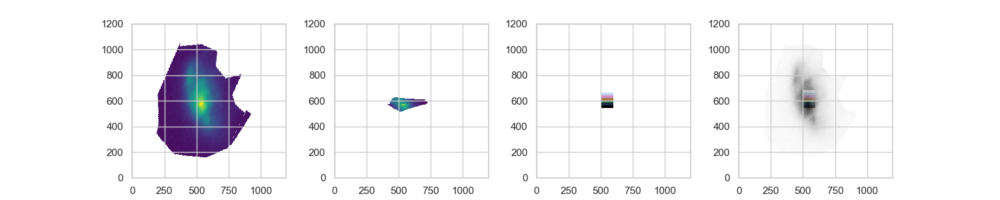

In [105]:
# Load data
complete_im = fits.getdata('../Data/LensigStuff/MACS1206/SP_HST/SP_snake_ci_F160w.fits')
complete_im_header = fits.getheader('../Data/LensigStuff/MACS1206/SP_HST/SP_snake_ci_F160w.fits')
incomplete_im,_ = reproject_interp('../Data/LensigStuff/MACS1206/SP_HST/SP_snake_F160w_north.fits',complete_im_header)
complete_im[np.where(complete_im==0)] = np.nan
incomplete_im[np.where(incomplete_im==0)] = np.nan

# Some physical measurements
pix_to_kpc = complete_im_header['CDELT2']*u.deg.to(u.arcsec)/cosmo.arcsec_per_kpc_proper(z=1.033).value
print('Pixel size in kpc %0.4f'%pix_to_kpc)
print('Size of the galaxy %0.2f kpc'%(500*pix_to_kpc))
print('Size of the step %0.2f kpc'%(20*pix_to_kpc))
print('Lenght of the step %0.2f kpc'%(100*pix_to_kpc))

# Make a grid with 1 x 1 kpc grids ~ 40 x 40 pixels
step = 20
grid = np.zeros_like(complete_im)
i = 0
for p in range(525,685,step):
    grid[p:p+step,500:600] = i 
    i+=1
        
print('Number of pix ',i)

grid[np.where(grid == 0)] = np.nan

fig, ax = plt.subplots(1,4,figsize=(15,3))
ax[0].imshow(complete_im,origin='lower',cmap='viridis')
ax[1].imshow(incomplete_im,origin='lower',cmap='viridis')

ax[2].imshow(grid,origin='lower',cmap='cubehelix')

ax[3].imshow(complete_im,origin='lower',cmap='Greys')
ax[3].imshow(grid,origin='lower',cmap='cubehelix',alpha=0.5)

#fits.writeto('../Data/LensigStuff/MACS1206/SP_HST/SP_snake_ci_grid.fits',data=grid,header=complete_im_header,overwrite=True)

Use lenstool to simulate this in image plane for the snake part

In [79]:
grid_snake,_ = reproject_interp('../Data/LensigStuff/MACS1206/simul_grid.fits',alma_header)
grid_snake = crop_image(grid_snake)

and plot

<IPython.core.display.Javascript object>


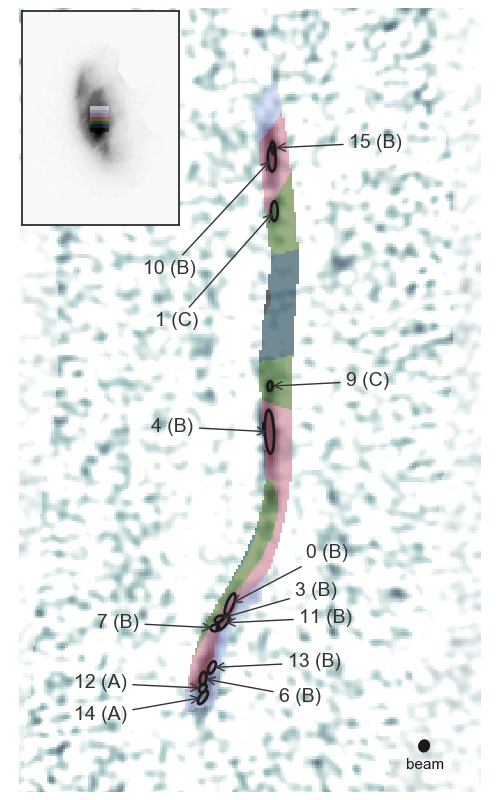

In [148]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
sns.set_style('white')
fig, ax = plt.subplots(1,1,figsize=(5,8))
fig.subplots_adjust(top=0.99,bottom=0.01,left=0.01,right=0.99)

# ALMA data
ax.imshow(alma_im,origin='lower',cmap='bone_r',vmin=0,vmax=0.0004)

# All the clumps shanningans

i,f = 1,-1
align = 'left'
disp = {0:20,3:10,6:-10,14:-10,10:-50,1:-50}
        
translate = {c['_idx']:i for i,c in enumerate(cat_final)}
mean_value = {}

clump_id = {1:'A',2:'B',3:'C'}

for clump in cat_final:
    
    # Plot contour
    leaf = d_final.leaves[translate[clump['_idx']]]
    s = PPVStatistic(leaf)
    ax.add_patch(s.to_mpl_ellipse(facecolor='None',edgecolor='k',linewidth=2))
    
    s = PPVStatistic(leaf)
    mask = np.sum(leaf.get_mask(),axis=0)
    grid_value = np.nanmean(grid_snake[np.where(mask>0)])
    mean_value[clump['_idx']] = grid_value 
    
    # Plot annotation
    plt.annotate('%d (%s)'%(clump['_idx'],clump_id[np.round(grid_value)]), 
                 xy=(clump['x_cen'], clump['y_cen']),
                 xytext=(clump['x_cen']+33*i, clump['y_cen']+disp.get(clump['_idx'],0)), 
                 arrowprops=dict(arrowstyle='->',color='0.2'),
                 fontsize=14,fontweight='normal',color='0.2',
                 horizontalalignment=align)
    i*=-1
    
    if align == 'left': align = 'right'
    else: align = 'left'

ax.imshow(grid_snake,origin='lower',cmap='cubehelix_r',alpha=0.6)

ax.add_artist(Ellipse(xy=(175,50), width=4.3442E-05/8.333E-06, height=3.8018E-05/8.333E-06, angle=7.287213897705E+01, color='k'))
ax.annotate('beam',(167,40),color='k',fontsize=11)

ax.axis('off')
ax.set_ylim(30,370)


# Inset
image_to_plot = complete_im.copy()
image_to_plot[np.where(np.isnan(complete_im))] = 0

axins = zoomed_inset_axes(ax, 0.08, loc=2,borderpad=0.2 )
axins.imshow(image_to_plot[40:,130:-220],origin='lower',cmap='Greys',vmax=0.12)
axins.imshow(grid[40:,130:-220],origin='lower',cmap='cubehelix',alpha=0.6)
axins.tick_params(labelbottom=False,labelleft=False)

fig.savefig('../Plots/snake_clump_identification.jpeg')

In [ ]:
Associacions:
   
    simple ones (from centre and north)
        A (2) - 10,15,4,0,3,11,13,6,7
        B (3) - 1,9
        C (1) - 14
        D (1) - 12

In [ ]:
OLD

In [ ]:
import glob         
import os
sns.set(font_scale=1.7)

fig, allax = plt.subplots(1,8,figsize=(18,5.5))
fig.subplots_adjust(top=0.95,bottom=0.01,left=0.01,right=0.99,hspace=0.3)

color_clump = {8:'#01386a', 4:'#01386a', 7:'#01386a',10:'#01386a',6:'#01386a',
               2:'#c20078',9:'#c20078', 1:'#c20078',0:'#c20078',3:'#c20078',
               5:'#e50000',
               12:'#f97306',
               11:'#3f9b0b',
               13:'#047495'}

xdisp = {2:-25,9:-25,1:-25,3:-25,7:-25,6:-25,11:-35}
ydisp = {0:20,3:20,7:10,6:10,13:-10}

for ax in allax[:-2]:
    ax.imshow(alma_im,origin='lower',cmap='bone_r',vmin=0,vmax=0.0006)
    for clump in cat_final:
        leaf = d_final.leaves[clump.index]
        s = PPVStatistic(leaf)
        ax.add_patch(s.to_mpl_ellipse(facecolor='None',edgecolor='k',linewidth=2))
        ax.annotate('%d'%clump.index, 
                    xy=(clump['x_cen'], clump['y_cen']),
                     xytext=(clump['x_cen']+xdisp.get(clump.index,25), clump['y_cen']+ydisp.get(clump.index,0)), 
                     arrowprops=dict(arrowstyle='->',color='0.2'),
                     fontsize=18,fontweight='bold',color=color_clump.get(clump.index,'k'),
                     horizontalalignment='left')

## For each clump in the south
letter = ['A','B','C','D','E','F']
for n,c in enumerate([8,2,5,12,11,13]):
    
    ax = allax[n]
    ax.set_title(letter[n],color=color_clump.get(c,'k'),fontweight='bold')

    sp_file = '../Data/LensigStuff/MACS1206/clumps/simul_snake_clump_ellipse_'+str(c)+'.fits'
    if os.path.isfile(sp_file):
        im,_ = reproject_interp(sp_file,alma_header)
        im = crop_image(im)
        ax.contour(im,origin='lower',levels=[0.001],colors=color_clump.get(c,'k'),linewidths=2.0,linestyle='--',alpha=0.7) 

    # Prettiness
    ax.set_ylim(50,350)
    ax.set_xlim(40,150)
    ax.axis('off')
    

## Velocity
sns.set_style('white')
allax[6].remove()
allax[7].remove()
gs = allax[6].get_gridspec()
axbig = fig.add_subplot(gs[-2:])

i=0
for clump in cat_final:
    c = color_clump.get(clump.index,'k')
    leaf = d_final.leaves[clump.index]
    vmin, vmax  = np.min(leaf.indices()[0]),np.max(leaf.indices()[0])
    axbig.errorbar(x=[vmin,vmax],y=i,color=c)
    axbig.annotate(clump.index,xy=(vmin-2.5,i-0.2),color=c)
    i+=1

sns.despine(left=True,offset=-43)
axbig.tick_params(labelleft='off')
axbig.set_xlim(-2,35)
axbig.set_ylim(-3,14)
axbig.set_xlabel('Channel')

fig.savefig('../Plots/snake_clump_identification_vertical_10kms.jpeg')